# Proyecto Final
## Temática: Sistema Crediticio

#### Curso: Data Science
#### Alumnos: Adrián Spesot, Alejo Romano y Armando López

#### Tutor: Johan Caicedo

In [1]:
#from google.colab import drive
#drive.mount('/content/drive')

## Librerías

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, plot_confusion_matrix, confusion_matrix
from sklearn import model_selection
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LogisticRegression 



## Funciones

In [3]:
def no_outliers(df, column):
  Q1 = df[column].quantile(q = .25)
  Q3 = df[column].quantile(q = .75)
  IQR = Q3 - Q1
  
  df_sin_outlier = df[((df[column] > (Q1-1.5 * IQR)) & (df[column] < (Q3 + 1.5 * IQR)))]
  return df_sin_outlier

## Importación de datos

In [4]:
path_alejo = '/content/drive/MyDrive/Data Science - Coder House/Proyecto final/1er pre-entrega/1er pre-entrega/train.csv'
path_adri = '/content/drive/MyDrive/Data Science - Coder House/Desafíos Obligatorios/Proyecto_Final/1er pre-entrega/train.csv'
path = 'C:\\Users\\Adrian\\Escritorio\\CoderHouse\\DataScience\\ProyectoFinal\\train.csv'

df_credit = pd.read_csv(path)
df_credit.head(10) 

C:\Users\Adrian\AppData\Local\Temp\ipykernel_25348\1898346604.py:5: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  df_credit = pd.read_csv(path)


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good
5,0x1607,CUS_0xd40,June,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,27.262259,22 Years and 6 Months,No,49.574949,62.430172331195294,!@9#%8,340.4792117872438,Good
6,0x1608,CUS_0xd40,July,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,22.537593,22 Years and 7 Months,No,49.574949,178.3440674122349,Low_spent_Small_value_payments,244.5653167062043,Good
7,0x1609,CUS_0xd40,August,NaN,23,#F%$D@*&8,Scientist,19114.12,1824.843333,3,...,Good,809.98,23.933795,NaN,No,49.574949,24.785216509052056,High_spent_Medium_value_payments,358.12416760938714,Standard
8,0x160e,CUS_0x21b1,January,Rick Rothackerj,28_,004-07-5839,_______,34847.84,3037.986667,2,...,Good,605.03,24.464031,26 Years and 7 Months,No,18.816215,104.291825168246,Low_spent_Small_value_payments,470.69062692529184,Standard
9,0x160f,CUS_0x21b1,February,Rick Rothackerj,28,004-07-5839,Teacher,34847.84,3037.986667,2,...,Good,605.03,38.550848,26 Years and 8 Months,No,18.816215,40.39123782853101,High_spent_Large_value_payments,484.5912142650067,Good


In [5]:
df_credit.shape

(100000, 28)

## Análisis exploratorio de los datos (EDA)

In [6]:
df_credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

In [7]:
df_credit.describe(include = 'all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
ID,100000,100000,0x1602,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Customer_ID,100000,12500,CUS_0xd40,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Month,100000,8,January,12500,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Name,90015,10139,Langep,44,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,100000,1788,38,2833,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SSN,100000,12501,#F%$D@*&8,5572,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Occupation,100000,16,_______,7062,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Annual_Income,100000,18940,36585.12,16,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Monthly_Inhand_Salary,84998.0,NaN,NaN,NaN,4194.17085,3183.686167,303.645417,1625.568229,3093.745,5957.448333,15204.633333
Num_Bank_Accounts,100000.0,NaN,NaN,NaN,17.09128,117.404834,-1.0,3.0,6.0,7.0,1798.0


Se observa que algunas columnas son del tipo de variable incorrecto. Por otro lado, hay algunas variables que presentan datos faltantes y outliers.

### Variables no informativas

Las variables **ID**, **Customer_ID**, **Name** y **SSN** son variables identificadoras de los registros. Por tal motivo, se eliminan dado que no serán significativas para el modelo. Además, se elimina "Credit_History_Age" ya que no resulta importante para el modelo.

In [8]:
df_credit.drop(['ID', 'Customer_ID', 'Name', 'SSN', 'Credit_History_Age'], axis = 1, inplace = True)

### Preacondicionamiento de variables

Para esta sección, se corrige el tipo de variable y se realizan algunas modificaciones de los datos, como eliminación de guión bajo o codificación de variable.

Para empezar, se cambian las variables que son categóricas. La variable respuesta (**Credit_Score**) no se pasa a variable categórica dado que luego se va a codificar mediante números.

In [9]:
df_credit['Month'] = df_credit['Month'].astype('category')
df_credit['Occupation'] = df_credit['Occupation'].astype('category')
df_credit['Type_of_Loan'] = df_credit['Type_of_Loan'].astype('category')
df_credit['Credit_Mix'] = df_credit['Credit_Mix'].astype('category')
df_credit['Payment_of_Min_Amount'] = df_credit['Payment_of_Min_Amount'].astype('category')
df_credit['Payment_Behaviour'] = df_credit['Payment_Behaviour'].astype('category')

Se verifica los tipos de datos cambiados.

In [10]:
df_credit.dtypes

Month                       category
Age                           object
Occupation                  category
Annual_Income                 object
Monthly_Inhand_Salary        float64
Num_Bank_Accounts              int64
Num_Credit_Card                int64
Interest_Rate                  int64
Num_of_Loan                   object
Type_of_Loan                category
Delay_from_due_date            int64
Num_of_Delayed_Payment        object
Changed_Credit_Limit          object
Num_Credit_Inquiries         float64
Credit_Mix                  category
Outstanding_Debt              object
Credit_Utilization_Ratio     float64
Payment_of_Min_Amount       category
Total_EMI_per_month          float64
Amount_invested_monthly       object
Payment_Behaviour           category
Monthly_Balance               object
Credit_Score                  object
dtype: object

Con respecto a las variables numéricas, algunas presentan caracteres que impiden un correcto cambio de tipo de variable. Por ejemplo, algunos registros de la variable age presentan un guión bajo ('_'). Por lo tanto, se analiza una por una para corregir los datos y poder cambiar el tipo de variable.

#### Age

La variable **Age** presenta un guión bajo ('_') o más en los registros.

In [11]:
df_credit['Age'].value_counts()

38      2833
28      2829
31      2806
26      2792
32      2749
        ... 
471        1
1520       1
8663       1
3363       1
1342       1
Name: Age, Length: 1788, dtype: int64

In [12]:
df_credit['Age'] = df_credit['Age'].str.replace('_','')
df_credit['Age'] = df_credit['Age'].astype(np.int64)

#### Annual_Income

Esta variable también presenta '_' en los registros.

In [13]:
df_credit['Annual_Income'].value_counts()

36585.12     16
20867.67     16
17273.83     16
9141.63      15
33029.66     15
             ..
20269.93_     1
15157.25_     1
44955.64_     1
76650.12_     1
4262933.0     1
Name: Annual_Income, Length: 18940, dtype: int64

In [14]:
df_credit['Annual_Income'] = df_credit['Annual_Income'].str.replace('_','')
df_credit['Annual_Income'] = df_credit['Annual_Income'].astype(float)

#### Num_of_Loan

Esta variable también presenta '_' en los registros.

In [15]:
df_credit['Num_of_Loan'].value_counts()

3        14386
2        14250
4        14016
0        10380
1        10083
         ...  
1320_        1
103          1
1444         1
392          1
966          1
Name: Num_of_Loan, Length: 434, dtype: int64

In [16]:
df_credit['Num_of_Loan'] = df_credit['Num_of_Loan'].str.replace('_','')
df_credit['Num_of_Loan'] = df_credit['Num_of_Loan'].astype(np.int64)

#### Num_of_Delayed_Payment

También presenta '_' en los registros. Además, dado que tiene valores NaN, se pasa la variable a tipo float.

In [17]:
df_credit['Num_of_Delayed_Payment'].value_counts()

19      5327
17      5261
16      5173
10      5153
18      5083
        ... 
848_       1
4134       1
1530       1
1502       1
2047       1
Name: Num_of_Delayed_Payment, Length: 749, dtype: int64

In [18]:
df_credit['Num_of_Delayed_Payment'] = df_credit['Num_of_Delayed_Payment'].str.replace('_','')
df_credit['Num_of_Delayed_Payment'] = df_credit['Num_of_Delayed_Payment'].astype(float)

#### Outstanding_Debt

Presenta '_' en los registros.

In [19]:
df_credit['Outstanding_Debt'].value_counts()

1360.45     24
460.46      23
1151.7      23
1109.03     23
467.7       16
            ..
245.46_      1
645.77_      1
174.79_      1
1181.13_     1
1013.53_     1
Name: Outstanding_Debt, Length: 13178, dtype: int64

In [20]:
df_credit['Outstanding_Debt'] = df_credit['Outstanding_Debt'].str.replace('_','')
df_credit['Outstanding_Debt'] = df_credit['Outstanding_Debt'].astype(float)

#### Changed_Credit_Limit

Presenta '_' en los registros. Además, hay registros que solo tienen el guión bajo, por lo que al reemplazar dicho caracter, el registro pasa a estar vacío. Por esta razón, se lo reemplaza con un NaN.

In [21]:
df_credit['Changed_Credit_Limit'].value_counts()

_                     2091
8.22                   133
11.5                   127
11.32                  126
7.35                   121
                      ... 
-1.84                    1
0.8899999999999999       1
28.06                    1
1.5599999999999996       1
21.17                    1
Name: Changed_Credit_Limit, Length: 4384, dtype: int64

In [22]:
df_credit['Changed_Credit_Limit'] = df_credit['Changed_Credit_Limit'].str.replace('_','')

for i in range(len(df_credit['Changed_Credit_Limit'])):
  if df_credit['Changed_Credit_Limit'].iloc[i] == '':
    df_credit.at[i, 'Changed_Credit_Limit'] = float('NaN')

In [23]:
df_credit['Changed_Credit_Limit'] = df_credit['Changed_Credit_Limit'].astype(float)

In [24]:
df_credit['Changed_Credit_Limit'].describe()

count    97909.000000
mean        10.389025
std          6.789496
min         -6.490000
25%          5.320000
50%          9.400000
75%         14.870000
max         36.970000
Name: Changed_Credit_Limit, dtype: float64

#### Amount_invested_monthly

In [25]:
df_credit['Amount_invested_monthly'].value_counts()

__10000__             4305
0.0                    169
80.41529543900253        1
36.66235139442514        1
89.7384893604547         1
                      ... 
36.541908593249026       1
93.45116318631192        1
140.80972223052834       1
38.73937670100975        1
167.1638651610451        1
Name: Amount_invested_monthly, Length: 91049, dtype: int64

In [26]:
df_credit['Amount_invested_monthly'] = df_credit['Amount_invested_monthly'].str.replace('_','')
df_credit['Amount_invested_monthly'] = df_credit['Amount_invested_monthly'].astype(float)

#### Monthly_Balance

In [27]:
df_credit["Monthly_Balance"].value_counts()

__-333333333333333333333333333__    9
312.49408867943663                  1
415.32532309844316                  1
252.08489793906085                  1
254.9709216273975                   1
                                   ..
366.2890379762706                   1
151.1882696261166                   1
306.75027851710234                  1
278.8720257394474                   1
393.6736955618808                   1
Name: Monthly_Balance, Length: 98792, dtype: int64

Se considera "_-333333333333333333333333333_" como valores erróneos, por lo que se eliminan del dataset.

In [28]:
df_credit = df_credit[df_credit['Monthly_Balance'] != "__-333333333333333333333333333__"]
df_credit.reset_index(inplace=True, drop=True)

In [29]:
df_credit['Monthly_Balance'] = df_credit['Monthly_Balance'].str.replace('_','')
df_credit['Monthly_Balance'] = df_credit['Monthly_Balance'].astype(float)

#### Verificación de tipos de variables

In [30]:
df_credit.dtypes

Month                       category
Age                            int64
Occupation                  category
Annual_Income                float64
Monthly_Inhand_Salary        float64
Num_Bank_Accounts              int64
Num_Credit_Card                int64
Interest_Rate                  int64
Num_of_Loan                    int64
Type_of_Loan                category
Delay_from_due_date            int64
Num_of_Delayed_Payment       float64
Changed_Credit_Limit         float64
Num_Credit_Inquiries         float64
Credit_Mix                  category
Outstanding_Debt             float64
Credit_Utilization_Ratio     float64
Payment_of_Min_Amount       category
Total_EMI_per_month          float64
Amount_invested_monthly      float64
Payment_Behaviour           category
Monthly_Balance              float64
Credit_Score                  object
dtype: object

### Datos faltantes

En el siguiente código, se observa que hay 7 variables con datos faltantes, y se muestra la cantidad por variable. Se puede notar que la variable **Monthly_Inhand_Salary** es la que presenta más datos faltantes.

In [31]:
df_credit.isna().sum()

Month                           0
Age                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15001
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit         2091
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4478
Payment_Behaviour               0
Monthly_Balance              2868
Credit_Score                    0
dtype: int64

#### Monthly_Inhand_Salary

Dado que la cantidad de datos faltantes es grande, una imputación podría afectar la información del dataset. Además, se observa que hay otra variable con información de los ingresos ("Annual_Income") y que no presenta datos faltantes. Por todo esto, se decide analizar la correlación que hay entre las dos variables.

Para empezar, se crea un dataframe con las dos variables a analizar. Esto se separa del dataframe original para realizar cambios que no afecten a todo el dataset.

In [32]:
df_salary = df_credit[['Annual_Income', 'Monthly_Inhand_Salary']]
df_salary.describe()

,Annual_Income,Monthly_Inhand_Salary
count,9.999100e+04,84990.000000
mean,1.764268e+05,4194.150202
std,1.429682e+06,3183.698715
min,7.005930e+03,303.645417
25%,1.945650e+04,1625.558333
50%,3.757861e+04,3093.745000
75%,7.279092e+04,5957.448333
max,2.419806e+07,15204.633333


Primero se eliminan las filas que presenten NaNs. Hay que recordar que solo la variable "Monthly_Inhand_Salary" es la que presentaba datos faltantes.

In [33]:
df_salary.dropna(inplace = True);
df_salary.isna().sum()

C:\Users\Adrian\AppData\Local\Temp\ipykernel_25348\3367357970.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_salary.dropna(inplace = True);


Annual_Income            0
Monthly_Inhand_Salary    0
dtype: int64

Luego, se utiliza la función "no_outliers" para eliminar aquellos puntos considerados outliers, teniendo en mente el gráfico boxplot.

In [34]:
df_salary = no_outliers(df_salary, 'Monthly_Inhand_Salary')
df_salary = no_outliers(df_salary, 'Annual_Income')

Finalmente, se realiza la correlación entre las dos variables.

In [35]:
df_salary['Monthly_Inhand_Salary'].corr(df_salary['Annual_Income'])

0.9978272598954341

Se observa que hay una alta correlación (0.9978), por lo que se podría decir que ambas variables presentan la misma información, lo cual es redundante. Por lo tanto, se decide eliminar la variable "Monthly_Inhand_Salary" dado que es la que presenta una gran cantidad de datos faltantes, mientras que la otra variable está completa.

In [36]:
df_credit.drop(['Monthly_Inhand_Salary'], axis = 1, inplace = True)

#### Type_of_Loan

In [37]:
# Eliminamos todas las filas del dataset donde en Type_of_loan sea NaN
df_credit = df_credit[df_credit['Type_of_Loan'].notna()] 
df_credit.reset_index(inplace=True, drop = True)

Con respecto a esta variable, hay varios elementos dentro de cada registro. Por lo tanto, requiere de un preprocesamiento.

In [38]:
df_credit['Type_of_Loan'].tail()

88578    Auto Loan, and Student Loan
88579    Auto Loan, and Student Loan
88580    Auto Loan, and Student Loan
88581    Auto Loan, and Student Loan
88582    Auto Loan, and Student Loan
Name: Type_of_Loan, dtype: category
Categories (6260, object): ['Auto Loan', 'Auto Loan, Auto Loan, Auto Loan, Auto Loan, C..., 'Auto Loan, Auto Loan, Auto Loan, Auto Loan, S..., 'Auto Loan, Auto Loan, Auto Loan, Credit-Build..., ..., 'Student Loan, and Not Specified', 'Student Loan, and Payday Loan', 'Student Loan, and Personal Loan', 'Student Loan, and Student Loan']

In [39]:
list_type_loan = list(df_credit['Type_of_Loan'][~df_credit['Type_of_Loan'].isnull().values])  # Lista con todos los registros no nulos de la variable type_of_loan

unique_type_loan = []

for i in list_type_loan:      # Recorro los registros de list_type_loan
  values = i.split(',')       # Separo los valores de cada registro utilizando la coma como separador
  for value in values:        # Recorro los valores en cada lista de valores de los registros
    value = value.strip(' ')  # Saco los espacios al principio y al final de cada value
    if 'and' in value:        # Las ultimas opciones en cada registro tiene un 'and' al principio. Hay que sacarlos
      value = value[4 : ]
    if value not in unique_type_loan:   # Si el tipo de prestamo no esta en la lista, lo agrego
      unique_type_loan.append(value)

print(unique_type_loan)

['Auto Loan', 'Credit-Builder Loan', 'Personal Loan', 'Home Equity Loan', 'Not Specified', 'Mortgage Loan', 'Student Loan', 'Debt Consolidation Loan', 'Payday Loan']


Se observa que hay 9 tipos de préstamos, de los cuales uno es 'Not Specified'. Para que pueda ser utilizado en el modelo, se tendría que separar en 9 columnas indicando con un 1 la presencia de ese tipo de préstamo y con un 0 la no presencia. Esto sería obtener las variables dummies para la variable 'Type_of_Loan'.

In [40]:
# Se crean las futuras columnas con ceros. No se incluye el tipo 'Not Specified'
auto_loan = [0] * (df_credit.shape[0])
credit_builder_loan = [0] * (df_credit.shape[0])
personal_loan = [0] * (df_credit.shape[0])
home_equity_loan = [0] * (df_credit.shape[0])
mortgage_loan = [0] * (df_credit.shape[0])
student_loan = [0] * (df_credit.shape[0])
debt_consolidation_loan = [0] * (df_credit.shape[0])
payday_loan = [0] * (df_credit.shape[0])

In [41]:
# Aquellos registros que sean 'Not Specified', las columnas van a estar con todos 0. Si se desean eliminar, hay que chequear que sean todos ceros.
for i in range(df_credit.shape[0]):
  if str(df_credit['Type_of_Loan'][i]) != 'nan':
    values = df_credit['Type_of_Loan'][i].split(',')
    for value in values:        # Recorro los valores en cada lista de valores de los registros
      value = value.strip(' ')  # Saco los espacios al principio y al final de cada value
      if 'and' in value:        # Las ultimas opciones en cada registro tiene un 'and' al principio. Hay que sacarlos
        value = value[4 : ]
      if 'Auto Loan' == value:
          auto_loan[i] = 1
      
      if 'Credit-Builder Loan' == value:
          credit_builder_loan[i] = 1

      if 'Personal Loan' == value:
          personal_loan[i] = 1

      if 'Home Equity Loan' == value:
          home_equity_loan[i] = 1

      if 'Mortgage Loan' == value:
          mortgage_loan[i] = 1

      if 'Student Loan' == value:
          student_loan[i] = 1

      if 'Debt Consolidation Loan' == value:
          debt_consolidation_loan[i] = 1

      if 'Payday Loan' == value:
          payday_loan[i] = 1

In [42]:
# Se agregan las nuevas columnas al dataframe
df_credit['Auto_Loan'] = auto_loan
df_credit['Credit_Builder_Loan'] = credit_builder_loan
df_credit['Personal_Loan'] = personal_loan
df_credit['Home_Enquity_Loan'] = home_equity_loan
df_credit['Mortgage_Loan'] = mortgage_loan
df_credit['Student_Loan'] = student_loan
df_credit['Debt_Consolidation_Loan'] = debt_consolidation_loan
df_credit['Payday_Loan'] = payday_loan

In [43]:
# Se elimina la columna Type_of_Loan
df_credit.drop(['Type_of_Loan'], axis = 1, inplace = True)

In [44]:
df_credit.head(5)

,Month,Age,Occupation,Annual_Income,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,...,Monthly_Balance,Credit_Score,Auto_Loan,Credit_Builder_Loan,Personal_Loan,Home_Enquity_Loan,Mortgage_Loan,Student_Loan,Debt_Consolidation_Loan,Payday_Loan
0,January,23,Scientist,19114.12,3,4,3,4,3,7.0,...,312.494089,Good,1,1,1,1,0,0,0,0
1,February,23,Scientist,19114.12,3,4,3,4,-1,NaN,...,284.629162,Good,1,1,1,1,0,0,0,0
2,March,-500,Scientist,19114.12,3,4,3,4,3,7.0,...,331.209863,Good,1,1,1,1,0,0,0,0
3,April,23,Scientist,19114.12,3,4,3,4,5,4.0,...,223.451310,Good,1,1,1,1,0,0,0,0
4,May,23,Scientist,19114.12,3,4,3,4,6,NaN,...,341.489231,Good,1,1,1,1,0,0,0,0


#### Num_of_Delayed_Payment

Para imputar los datos faltantes de esta variable, se realiza un histograma para analizar su distribución. Al graficar, se observa que hay varios outliers, por lo que se decide limitar el eje X para observar mejor la mayor concentración de valores. Se observa que la variable no es simétrica y no se asemeja a una campana. Por lo tanto, se decide imputar los valores faltantes con la mediana de la variable.

[Text(0.5, 0, 'Num_of_Delayed_Payment'),
 Text(0, 0.5, 'Cantidad de observaciones'),
 Text(0.5, 1.0, 'Histograma del Num_of_Delayed_Payment'),
 (-200.0, 200.0)]

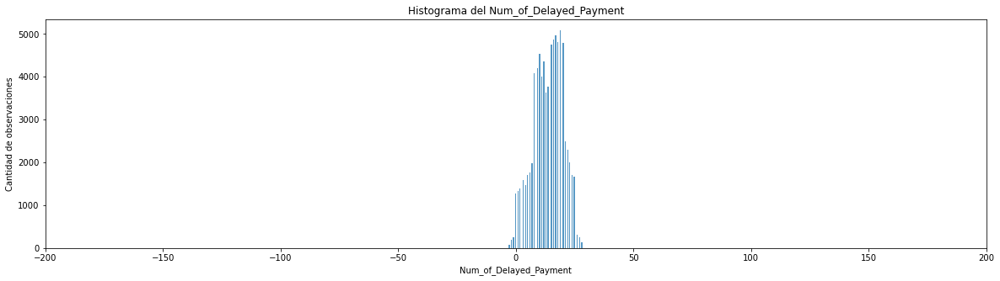

In [45]:
# Histograma
plt.figure(figsize=(20, 5))
ax = sns.histplot(df_credit, x = "Num_of_Delayed_Payment")

ax.set(xlabel = "Num_of_Delayed_Payment", ylabel = "Cantidad de observaciones", title = "Histograma del Num_of_Delayed_Payment", xlim=(-200, 200))

In [46]:
num_delay_pay_median = df_credit["Num_of_Delayed_Payment"].median()  # 14.0

df_credit["Num_of_Delayed_Payment"] = df_credit["Num_of_Delayed_Payment"].fillna(num_delay_pay_median)

A continuación, se verifica que no hayan quedado datos faltantes en la variable analizada.

In [47]:
df_credit['Num_of_Delayed_Payment'].isna().sum()

0

#### Changed_Credit_Limit

Para imputar los datos faltantes de esta variable, se realiza un histograma para analizar su distribución. Al graficar, se observa que la variable no es simétrica y no se asemeja a una campana. Por lo tanto, se decide imputar los valores faltantes con la mediana de la variable.

[Text(0.5, 0, 'Changed_Credit_Limit'),
 Text(0, 0.5, 'Cantidad de observaciones'),
 Text(0.5, 1.0, 'Histograma del Changed_Credit_Limit')]

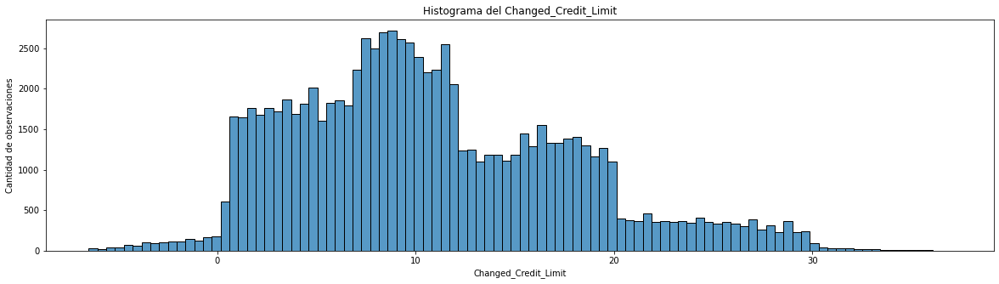

In [48]:
# Histograma
plt.figure(figsize=(20, 5))
ax = sns.histplot(df_credit, x = "Changed_Credit_Limit")

ax.set(xlabel = "Changed_Credit_Limit", ylabel = "Cantidad de observaciones", title = "Histograma del Changed_Credit_Limit")

In [49]:
credit_limit_median = df_credit["Changed_Credit_Limit"].median()  # 9.4

df_credit["Changed_Credit_Limit"] = df_credit["Changed_Credit_Limit"].fillna(credit_limit_median)

A continuación, se verifica que no hayan quedado datos faltantes en la variable analizada.

In [50]:
df_credit['Num_of_Delayed_Payment'].isna().sum()

0

#### Num_Credit_Inquiries

Para imputar los datos faltantes de esta variable, se realiza un histograma para analizar su distribución. Al graficar, se observa que hay varios outliers y que la variable no es simétrica y no se asemeja a una campana. Por lo tanto, se decide imputar los valores faltantes con la mediana de la variable.

(-80.0, 80.0)

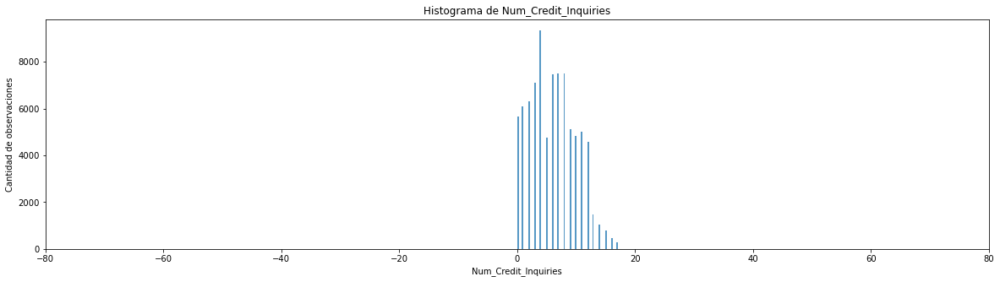

In [51]:
# Histograma
plt.figure(figsize=(20, 5))
ax = sns.histplot(df_credit, x = "Num_Credit_Inquiries")

ax.set(xlabel = "Num_Credit_Inquiries", ylabel = "Cantidad de observaciones", title = "Histograma de Num_Credit_Inquiries")
plt.xlim(-80, 80)

In [52]:
num_credit_inq_median = df_credit["Num_Credit_Inquiries"].median()  # 6.0

df_credit["Num_Credit_Inquiries"] = df_credit["Num_Credit_Inquiries"].fillna(num_credit_inq_median)

A continuación, se verifica que no hayan quedado datos faltantes en la variable analizada.

In [53]:
df_credit['Num_Credit_Inquiries'].isna().sum()

0

#### Amount_invested_monthly

Para imputar los datos faltantes de esta variable, se realiza un histograma para analizar su distribución. Al graficar, se observa que hay varios outliers y que la variable no es simétrica y no se asemeja a una campana. Por lo tanto, se decide imputar los valores faltantes con la mediana de la variable.

[Text(0.5, 0, 'Amount_invested_monthly'),
 Text(0, 0.5, 'Cantidad de observaciones'),
 Text(0.5, 1.0, 'Histograma de Amount_invested_monthly')]

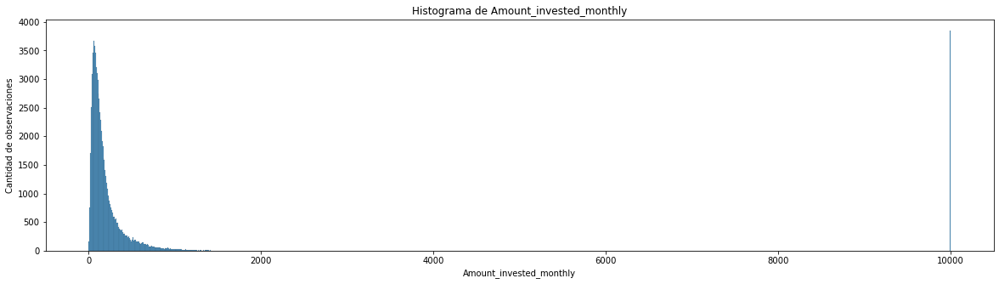

In [54]:
# Histograma
plt.figure(figsize=(20, 5))
ax = sns.histplot(df_credit, x = "Amount_invested_monthly")

ax.set(xlabel = "Amount_invested_monthly", ylabel = "Cantidad de observaciones", title = "Histograma de Amount_invested_monthly")

In [55]:
amount_inv_month_median = df_credit["Amount_invested_monthly"].median()  # 135.92568154608836

df_credit["Amount_invested_monthly"] = df_credit["Amount_invested_monthly"].fillna(amount_inv_month_median)

A continuación, se verifica que no hayan quedado datos faltantes en la variable analizada.

In [56]:
df_credit['Amount_invested_monthly'].isna().sum()

0

#### Monthly_Balance

Para esta variable también se utiliza la mediana.

In [57]:
month_balance_median = df_credit["Monthly_Balance"].median()  # 336.44926592668395

df_credit["Monthly_Balance"] = df_credit["Monthly_Balance"].fillna(month_balance_median)

A continuación, se verifica que no hayan quedado datos faltantes en la variable analizada.

In [58]:
df_credit['Monthly_Balance'].isna().sum()

0

#### Verificación

In [59]:
df_credit.isna().sum()

Month                       0
Age                         0
Occupation                  0
Annual_Income               0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_of_Loan                 0
Delay_from_due_date         0
Num_of_Delayed_Payment      0
Changed_Credit_Limit        0
Num_Credit_Inquiries        0
Credit_Mix                  0
Outstanding_Debt            0
Credit_Utilization_Ratio    0
Payment_of_Min_Amount       0
Total_EMI_per_month         0
Amount_invested_monthly     0
Payment_Behaviour           0
Monthly_Balance             0
Credit_Score                0
Auto_Loan                   0
Credit_Builder_Loan         0
Personal_Loan               0
Home_Enquity_Loan           0
Mortgage_Loan               0
Student_Loan                0
Debt_Consolidation_Loan     0
Payday_Loan                 0
dtype: int64

In [60]:
df_credit.describe(include = "all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Month,88583,8,January,11074,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,88583.0,NaN,NaN,NaN,109.874095,685.326167,-500.0,24.0,33.0,42.0,8697.0
Occupation,88583,16,_______,6196,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Annual_Income,88583.0,NaN,NaN,NaN,174601.224644,1433001.776642,7005.93,18967.13,36585.12,70414.1,24198062.0
Num_Bank_Accounts,88583.0,NaN,NaN,NaN,17.197329,117.074385,-1.0,4.0,6.0,8.0,1798.0
Num_Credit_Card,88583.0,NaN,NaN,NaN,22.379441,128.225357,0.0,4.0,6.0,7.0,1499.0
Interest_Rate,88583.0,NaN,NaN,NaN,73.795796,468.986054,1.0,8.0,15.0,22.0,5797.0
Num_of_Loan,88583.0,NaN,NaN,NaN,3.381936,62.347598,-100.0,2.0,4.0,6.0,1496.0
Delay_from_due_date,88583.0,NaN,NaN,NaN,22.020218,15.242504,-5.0,10.0,19.0,29.0,67.0
Num_of_Delayed_Payment,88583.0,NaN,NaN,NaN,30.273676,219.264219,-3.0,10.0,14.0,18.0,4397.0


### Datos duplicados

Se puede observar que el dataset no cuenta con datos duplicados

In [61]:
df_credit.duplicated().sum()

0

## Filtro de Datos

En este caso, se aplica un filtro de Edad que comprende entre 18 y 56 años.

In [62]:
df_credit = df_credit[(df_credit['Age']>=18) & (df_credit['Age']<=56)]
df_credit.reset_index(inplace=True, drop=True)

In [63]:
df_credit.shape

(80585, 29)

In [64]:
df_credit

,Month,Age,Occupation,Annual_Income,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,...,Monthly_Balance,Credit_Score,Auto_Loan,Credit_Builder_Loan,Personal_Loan,Home_Enquity_Loan,Mortgage_Loan,Student_Loan,Debt_Consolidation_Loan,Payday_Loan
0,January,23,Scientist,19114.12,3,4,3,4,3,7.0,...,312.494089,Good,1,1,1,1,0,0,0,0
1,February,23,Scientist,19114.12,3,4,3,4,-1,14.0,...,284.629162,Good,1,1,1,1,0,0,0,0
2,April,23,Scientist,19114.12,3,4,3,4,5,4.0,...,223.451310,Good,1,1,1,1,0,0,0,0
3,May,23,Scientist,19114.12,3,4,3,4,6,14.0,...,341.489231,Good,1,1,1,1,0,0,0,0
4,June,23,Scientist,19114.12,3,4,3,4,8,4.0,...,340.479212,Good,1,1,1,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80580,April,25,Mechanic,39628.99,4,6,7,2,23,7.0,...,324.814448,Poor,1,0,0,0,0,1,0,0
80581,May,25,Mechanic,39628.99,4,6,7,2,18,7.0,...,324.814448,Poor,1,0,0,0,0,1,0,0
80582,June,25,Mechanic,39628.99,4,6,5729,2,27,6.0,...,324.814448,Poor,1,0,0,0,0,1,0,0
80583,July,25,Mechanic,39628.99,4,6,7,2,20,14.0,...,324.814448,Standard,1,0,0,0,0,1,0,0


Además, hay algunas variables que presentan valores negativos. A continuación, se eliminan estos registros. La variable **Num_Bank_Accounts** no se elimina el negativo, dado que puede significar que la persona no tiene una cuenta de banco. Esto se pensó dado que hay un solo valor negativo (-1).

In [65]:
df_credit = df_credit[df_credit['Num_of_Loan'] >= 0]
df_credit = df_credit[df_credit['Delay_from_due_date'] >= 0]
df_credit = df_credit[df_credit['Num_of_Delayed_Payment'] >= 0]
df_credit = df_credit[df_credit['Changed_Credit_Limit'] >= 0]

df_credit.reset_index(inplace=True, drop=True)

In [66]:
df_credit.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,75333.0,34.072677,9.911778e+00,18.000000,26.000000,34.000000,42.000000,5.600000e+01
Annual_Income,75333.0,176237.655158,1.445394e+06,7006.035000,19070.620000,36760.860000,71131.530000,2.419806e+07
Num_Bank_Accounts,75333.0,17.469051,1.189432e+02,-1.000000,4.000000,6.000000,8.000000,1.798000e+03
Num_Credit_Card,75333.0,22.293815,1.275746e+02,0.000000,4.000000,6.000000,7.000000,1.499000e+03
Interest_Rate,75333.0,74.332524,4.731958e+02,1.000000,8.000000,15.000000,21.000000,5.797000e+03
Num_of_Loan,75333.0,7.443418,5.930940e+01,1.000000,2.000000,4.000000,6.000000,1.496000e+03
Delay_from_due_date,75333.0,21.794791,1.503008e+01,0.000000,10.000000,19.000000,29.000000,6.700000e+01
Num_of_Delayed_Payment,75333.0,30.652967,2.216122e+02,0.000000,10.000000,14.000000,18.000000,4.397000e+03
Changed_Credit_Limit,75333.0,10.791960,6.694342e+00,0.000000,5.810000,9.690000,15.230000,3.649000e+01
Num_Credit_Inquiries,75333.0,27.385303,1.900666e+02,0.000000,3.000000,6.000000,9.000000,2.597000e+03


In [67]:
df_credit.shape

(75333, 29)

## Análisis univariado

#### Variables categoricas

##### Columnas con variables categoricas

In [68]:
print(df_credit.columns[df_credit.dtypes == 'category'])

Index(['Month', 'Occupation', 'Credit_Mix', 'Payment_of_Min_Amount',
       'Payment_Behaviour'],
      dtype='object')


##### Month

In [69]:
df_credit.groupby('Month')['Month'].count()

Month
April       9395
August      9458
February    9364
January     9335
July        9460
June        9418
March       9437
May         9466
Name: Month, dtype: int64

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


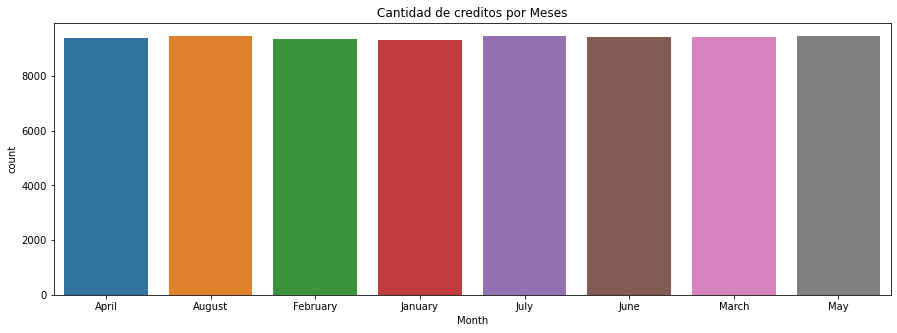

In [70]:
plt.figure(figsize=(15,5))
plt.title('Cantidad de creditos por Meses');
sns.countplot(df_credit.Month);

Se observa que en todos los meses hay cantidades similares de registros. No hay presencia de valores extraños.

##### Occupation

In [71]:
df_credit.groupby('Occupation')['Occupation'].count()

Occupation
Accountant       4702
Architect        4768
Developer        4647
Doctor           4707
Engineer         4759
Entrepreneur     4712
Journalist       4499
Lawyer           5058
Manager          4444
Mechanic         4822
Media_Manager    4602
Musician         4444
Scientist        4756
Teacher          4664
Writer           4497
_______          5252
Name: Occupation, dtype: int64

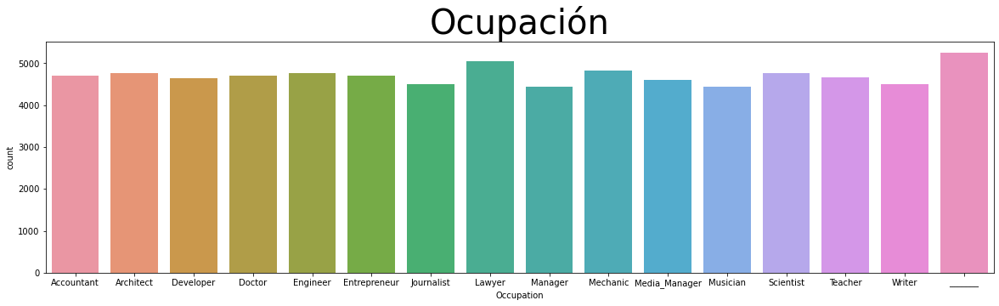

In [72]:
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(20,5))
sns.countplot(x='Occupation', data=df_credit);
plt.title('Ocupación', fontsize=40);

Es posible distinguir que la ocupación que mas resalta es Lawyer y a su vez tenemos varias ocupaciones no especificadas

###### Limpiamos valores

In [73]:
# Pasamos a NaN los valores '_______' y posteriormente eliminamos todas las filas
df_credit['Occupation'].replace({'_______':np.nan},inplace=True)
df_credit.dropna(inplace = True)

In [74]:
df_credit.groupby('Occupation')['Occupation'].count()

Occupation
Accountant       4702
Architect        4768
Developer        4647
Doctor           4707
Engineer         4759
Entrepreneur     4712
Journalist       4499
Lawyer           5058
Manager          4444
Mechanic         4822
Media_Manager    4602
Musician         4444
Scientist        4756
Teacher          4664
Writer           4497
Name: Occupation, dtype: int64

In [75]:
df_credit.shape

(70081, 29)

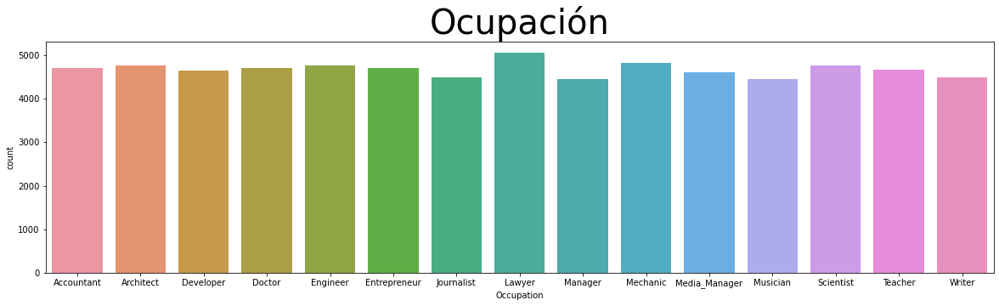

In [76]:
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(20,5))
sns.countplot(x='Occupation', data=df_credit);
plt.title('Ocupación', fontsize=40);

##### Credit_Mix

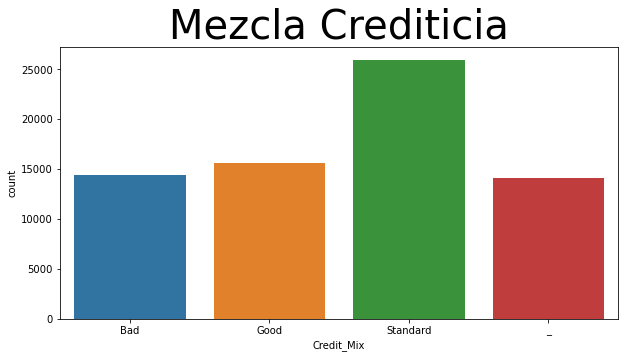

In [77]:
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(10,5))
sns.countplot(x='Credit_Mix', data=df_credit);
plt.title('Mezcla Crediticia', fontsize=40);

La mezcla crediticia mas solicitado es tipo Standard

Limpieza de Datos

In [78]:
# Pasamos a NaN los valores '_' y posteriormente eliminamos todas las filas
df_credit['Credit_Mix'].replace({'_':np.nan},inplace=True)
df_credit.dropna(inplace = True) # Eliminamos NaN

In [79]:
df_credit.shape

(55990, 29)

##### Payment_of_Min_Amount

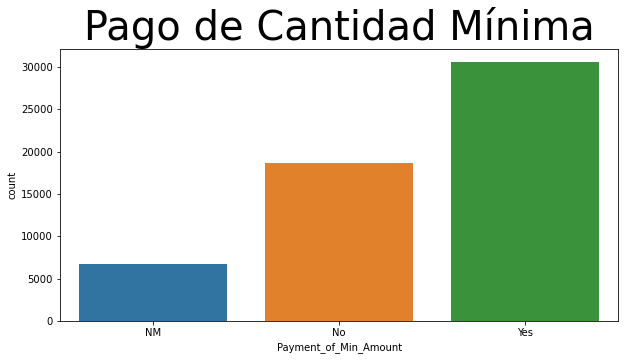

In [80]:
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(10,5))
sns.countplot(x='Payment_of_Min_Amount', data=df_credit);
plt.title('Pago de Cantidad Mínima', fontsize=40);

Limplieza de Datos

In [81]:
df_credit.groupby('Payment_of_Min_Amount')['Payment_of_Min_Amount'].count()

# Revisamos la cantidad de registros NM para posteriormente eliminarlos del dataframe

Payment_of_Min_Amount
NM      6765
No     18644
Yes    30581
Name: Payment_of_Min_Amount, dtype: int64

In [82]:
# Pasamos a NaN los valores 'NM' y posteriormente eliminamos todas las filas
df_credit['Payment_of_Min_Amount'].replace({'NM':np.nan},inplace=True)
df_credit.dropna(inplace = True)# Eliminamos NaN

In [83]:
df_credit.shape

(49225, 29)

##### Payment_Behaviour

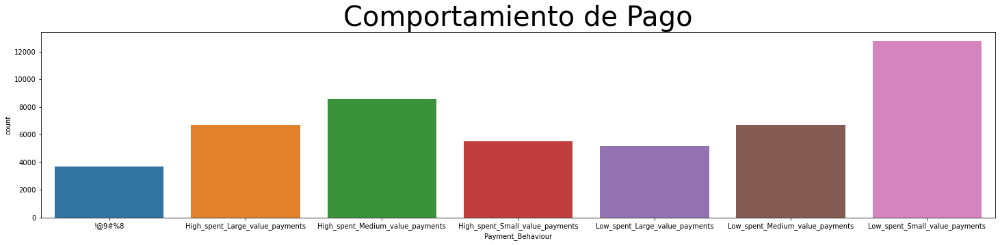

In [84]:
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(25,5))
sns.countplot(x='Payment_Behaviour', data=df_credit);
plt.title('Comportamiento de Pago', fontsize=40);

En el gráfico vemos como más frecuente a las personas con bajos gastos y pequeños pagos. 
Tambien se observa que tenemos con menor frecuencia personas con gastos altos y pequeños pagos.

Limplieza de Datos

In [85]:
df_credit.groupby('Payment_Behaviour')['Payment_Behaviour'].count()

Payment_Behaviour
!@9#%8                               3708
High_spent_Large_value_payments      6702
High_spent_Medium_value_payments     8572
High_spent_Small_value_payments      5531
Low_spent_Large_value_payments       5203
Low_spent_Medium_value_payments      6731
Low_spent_Small_value_payments      12778
Name: Payment_Behaviour, dtype: int64

In [86]:
# Pasamos a NaN los valores '!@9#%8' y posteriormente eliminamos todas las filas
df_credit['Payment_Behaviour'].replace({'!@9#%8':np.nan},inplace=True)
df_credit.dropna(inplace = True)

In [87]:
df_credit.shape

(45517, 29)

##### Credit_Score

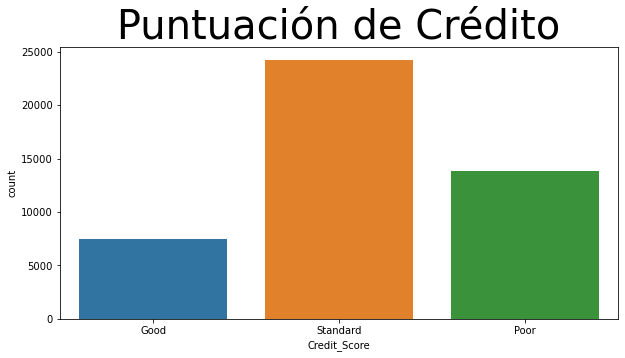

In [88]:
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(10,5))
sns.countplot(x='Credit_Score', data=df_credit);
plt.title('Puntuación de Crédito', fontsize=40);

En líneas generales, la mayoría de los créditos otorgados tienen una puntuacion de 1 es decir regular mientras que el de menor frecuencia es de puntuacion 2 es decir bueno

#### Variables Numericas

##### Colúmnas con variable Numericas del tipo Int y Float

In [89]:
# Mostramos las colúmnas con tipo de datos int y float64
print(df_credit.columns[df_credit.dtypes == 'int64'], '\n' ,df_credit.columns[df_credit.dtypes == 'float64'])

Index(['Age', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate',
       'Num_of_Loan', 'Delay_from_due_date', 'Auto_Loan',
       'Credit_Builder_Loan', 'Personal_Loan', 'Home_Enquity_Loan',
       'Mortgage_Loan', 'Student_Loan', 'Debt_Consolidation_Loan',
       'Payday_Loan'],
      dtype='object') 
 Index(['Annual_Income', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio',
       'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance'],
      dtype='object')


##### Age

In [90]:
df_credit['Age'].describe()

count    45517.000000
mean        34.110926
std          9.938630
min         18.000000
25%         26.000000
50%         34.000000
75%         42.000000
max         56.000000
Name: Age, dtype: float64

Como se observa en la descripción de los datos, tenemos valores muy atipicos, por lo que haremos un boxplot para evaluar los datos.

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

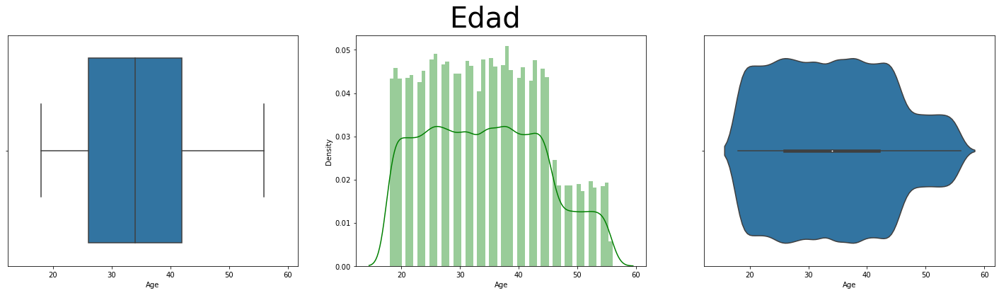

In [91]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Edad', fontsize=40);

sns.boxplot(df_credit.Age,ax = axes[0]);
sns.distplot(df_credit.Age,bins=56, color='g',ax = axes[1]);
sns.violinplot(df_credit.Age,orient='v');

En las gráficas presentes podemos observar que no tenemos presencia de outliers y que la distribución de datos es bastante amplia.
Tenemos una mayor concentracion de edades entre los 18 y 45 años

##### Annual_Income

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Annual_Income'>

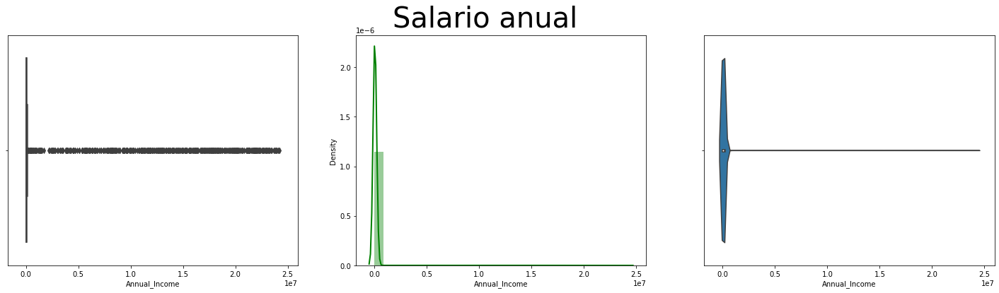

In [92]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Salario anual', fontsize=40)

sns.boxplot(df_credit.Annual_Income, ax = axes[0])
sns.distplot(df_credit.Annual_Income, bins=28,kde_kws={"lw": 2}, color='g',ax = axes[1])
sns.violinplot(df_credit.Annual_Income, orient='v')

Tratamos Outliers

In [93]:
df_credit = no_outliers(df_credit, 'Annual_Income')

Volvemos a Graficar

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Annual_Income'>

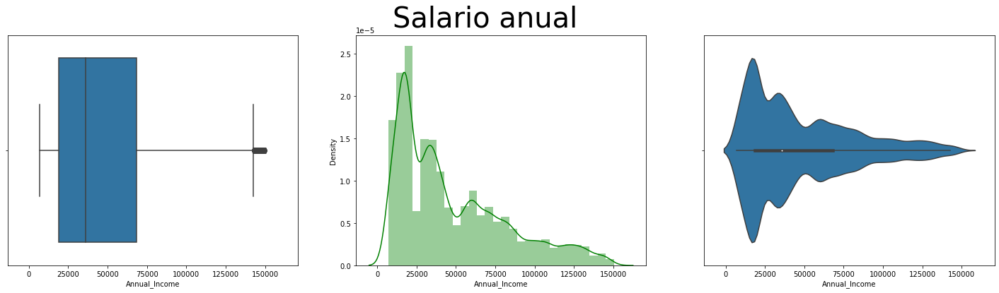

In [94]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Salario anual', fontsize=40)

sns.boxplot(df_credit.Annual_Income, ax = axes[0])
sns.distplot(df_credit.Annual_Income, bins=28, color='g', ax = axes[1])
sns.violinplot(df_credit.Annual_Income, orient='v')

In [95]:
df_credit['Annual_Income'].describe()

count     44230.000000
mean      47224.965855
std       34454.692871
min        7006.035000
25%       18750.540000
50%       35843.920000
75%       68299.040000
max      150339.960000
Name: Annual_Income, dtype: float64

##### Interest_Rate

In [96]:
df_credit.Interest_Rate.describe()

count    44230.000000
mean        77.619421
std        486.607132
min          1.000000
25%          8.000000
50%         15.000000
75%         22.000000
max       5797.000000
Name: Interest_Rate, dtype: float64

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Interest_Rate'>

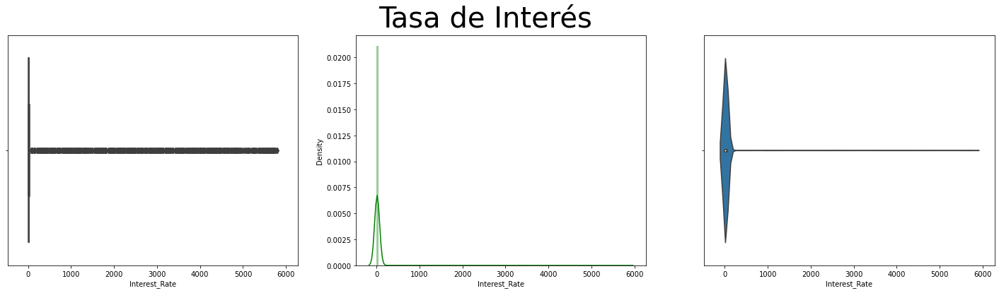

In [97]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Tasa de Interés', fontsize=40)

sns.boxplot(df_credit.Interest_Rate,ax = axes[0])
sns.distplot(df_credit.Interest_Rate,bins=125, color='g',ax = axes[1])
sns.violinplot(df_credit.Interest_Rate,orient='v')

Este es un caso tenemos gran asimetría en las gráficas, muchos valores ooutliers por lo que nos dá un grán valor de dispersión, a su vez vemos tazas muy superiores al 100% y esto resulta un valor muy atipico 

Tratamos Outliers

In [98]:
df_credit = no_outliers(df_credit, 'Interest_Rate')

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Interest_Rate'>

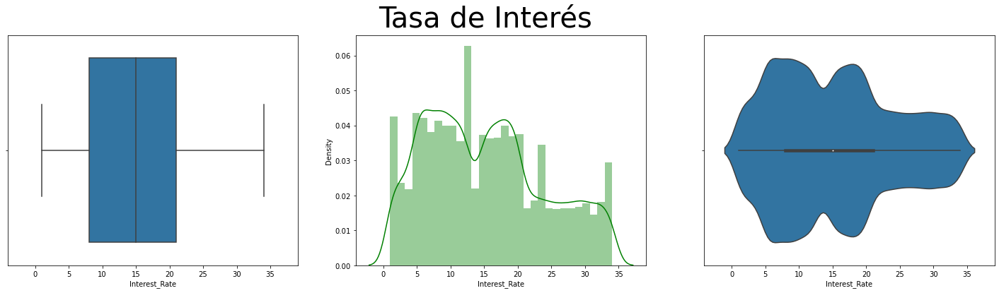

In [99]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Tasa de Interés', fontsize=40)

sns.boxplot(df_credit.Interest_Rate,ax = axes[0])
sns.distplot(df_credit.Interest_Rate,bins=30, color='g',ax = axes[1])
sns.violinplot(df_credit.Interest_Rate,orient='v')

In [100]:
df_credit['Interest_Rate'].describe()

count    43269.000000
mean        15.153597
std          8.815788
min          1.000000
25%          8.000000
50%         15.000000
75%         21.000000
max         34.000000
Name: Interest_Rate, dtype: float64

##### Num_Credit_Card

In [101]:
df_credit['Num_Credit_Card'].describe()

count    43269.000000
mean        22.319166
std        127.589707
min          0.000000
25%          4.000000
50%          6.000000
75%          7.000000
max       1497.000000
Name: Num_Credit_Card, dtype: float64

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Num_Credit_Card'>

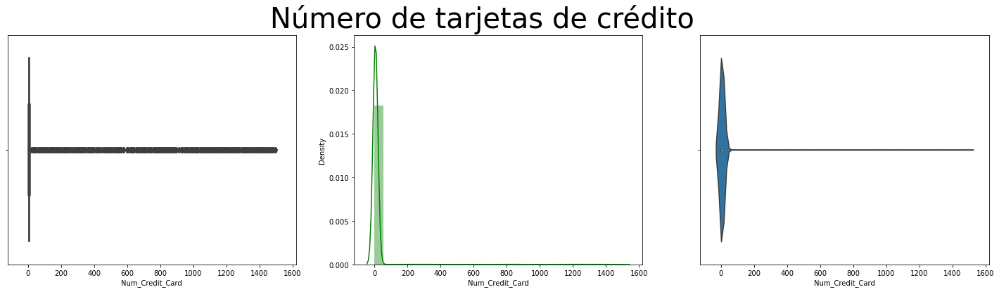

In [102]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Número de tarjetas de crédito', fontsize=40)

sns.boxplot(df_credit.Num_Credit_Card, ax = axes[0])
sns.distplot(df_credit.Num_Credit_Card, bins=28, color='g', ax = axes[1])
sns.violinplot(df_credit.Num_Credit_Card, orient='v')

Se puede observar en los gráficos que hay varios outliers. Se procede a eliminarlos.

In [103]:
df_credit_reducido = no_outliers(df_credit, 'Num_Credit_Card')

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Num_Credit_Card'>

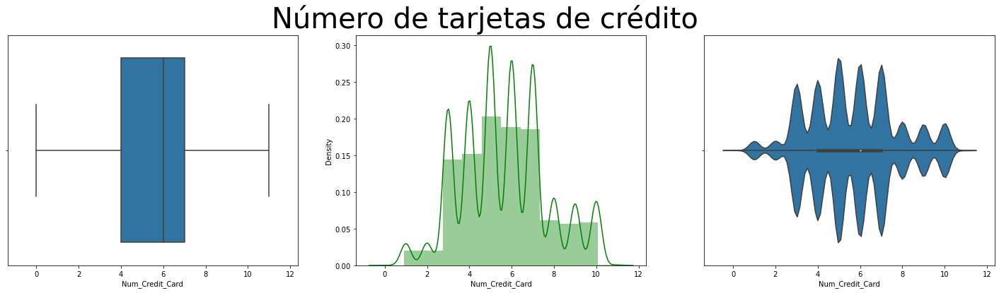

In [104]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Número de tarjetas de crédito', fontsize=40)

sns.boxplot(df_credit_reducido.Num_Credit_Card, ax = axes[0])
sns.distplot(df_credit_reducido.Num_Credit_Card, bins=12, color='g', ax = axes[1])
sns.violinplot(df_credit_reducido.Num_Credit_Card, orient='v')

In [105]:
df_credit['Num_Credit_Card'].describe()

count    43269.000000
mean        22.319166
std        127.589707
min          0.000000
25%          4.000000
50%          6.000000
75%          7.000000
max       1497.000000
Name: Num_Credit_Card, dtype: float64

##### Num_of_Delayed_Payment

In [106]:
df_credit.Num_of_Delayed_Payment.describe()

count    43269.000000
mean        30.891262
std        222.876900
min          0.000000
25%         10.000000
50%         14.000000
75%         18.000000
max       4397.000000
Name: Num_of_Delayed_Payment, dtype: float64

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Num_of_Delayed_Payment', ylabel='Density'>

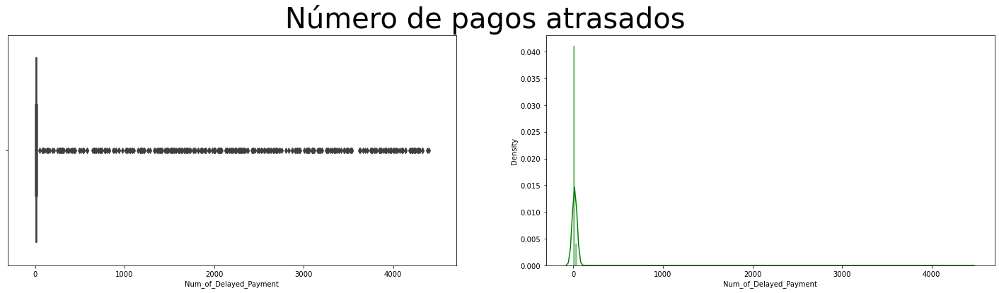

In [107]:
from ctypes import alignment
figure, ax = plt.subplots(1, 2, sharex=True, figsize=(25,6))

plt.suptitle('Número de pagos atrasados',fontsize=40) # Agrega un título general para todas las gráficas

sns.boxplot(df_credit.Num_of_Delayed_Payment, ax = ax[0])
sns.distplot(df_credit.Num_of_Delayed_Payment, bins=200, color='g',ax = ax[1])
# sns.violinplot(df_credit.Num_of_Delayed_Payment,orient='v')

Observamos una gran dispersión de datos con gran cantidad de valores outliers

Tratamos Outliers

In [108]:
df_credit = no_outliers(df_credit, 'Num_of_Delayed_Payment')

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Num_of_Delayed_Payment', ylabel='Density'>

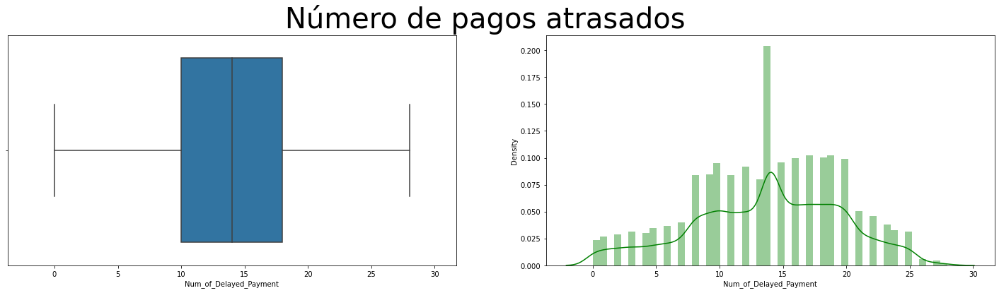

In [109]:
from ctypes import alignment
figure, ax = plt.subplots(1, 2, sharex=True, figsize=(25,6))

plt.suptitle('Número de pagos atrasados',fontsize=40) # Agrega un título general para todas las gráficas

sns.boxplot(df_credit.Num_of_Delayed_Payment, ax = ax[0])
sns.distplot(df_credit.Num_of_Delayed_Payment, bins=50, color='g',ax = ax[1])
# sns.violinplot(df_credit.Num_of_Delayed_Payment,orient='v')

In [110]:
df_credit['Num_of_Delayed_Payment'].describe()

count    42941.000000
mean        13.796581
std          5.881777
min          0.000000
25%         10.000000
50%         14.000000
75%         18.000000
max         28.000000
Name: Num_of_Delayed_Payment, dtype: float64

##### Num_Credit_Inquiries

In [111]:
df_credit.Num_Credit_Inquiries.describe()

count    42941.000000
mean        27.687245
std        192.872105
min          0.000000
25%          3.000000
50%          6.000000
75%          9.000000
max       2597.000000
Name: Num_Credit_Inquiries, dtype: float64

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Num_Credit_Inquiries'>

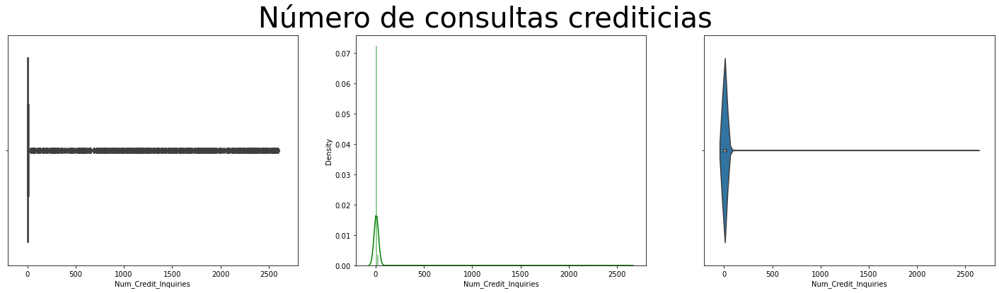

In [112]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Número de consultas crediticias', fontsize=40)

sns.boxplot(df_credit.Num_Credit_Inquiries,ax = axes[0])
sns.distplot(df_credit.Num_Credit_Inquiries,bins=200, color='g',ax = axes[1])
sns.violinplot(df_credit.Num_Credit_Inquiries,orient='v')

Tratamos Outliers

In [113]:
df_credit = no_outliers(df_credit, 'Num_Credit_Inquiries')

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Num_Credit_Inquiries'>

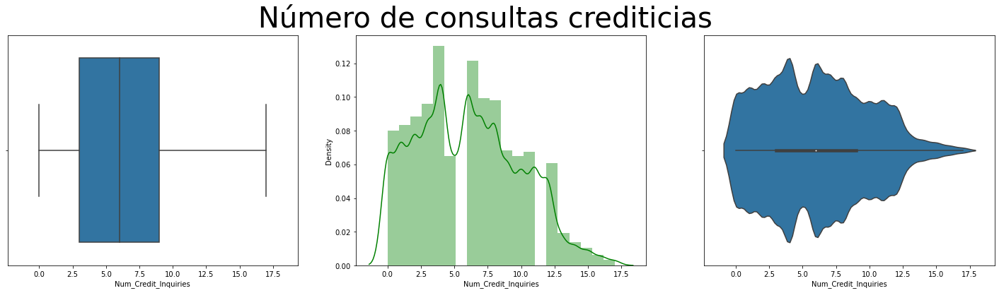

In [114]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Número de consultas crediticias', fontsize=40)

sns.boxplot(df_credit.Num_Credit_Inquiries,ax = axes[0])
sns.distplot(df_credit.Num_Credit_Inquiries,bins=20, color='g',ax = axes[1])
sns.violinplot(df_credit.Num_Credit_Inquiries,orient='v')

In [115]:
df_credit['Num_Credit_Card'].describe()

count    42236.000000
mean        22.362866
std        127.758914
min          0.000000
25%          4.000000
50%          6.000000
75%          7.000000
max       1497.000000
Name: Num_Credit_Card, dtype: float64

##### Outstanding_Debt

In [116]:
df_credit.Outstanding_Debt.describe()

count    42236.000000
mean      1498.291416
std       1193.697697
min          0.230000
25%        589.870000
50%       1223.300000
75%       2112.562500
max       4998.070000
Name: Outstanding_Debt, dtype: float64

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Outstanding_Debt'>

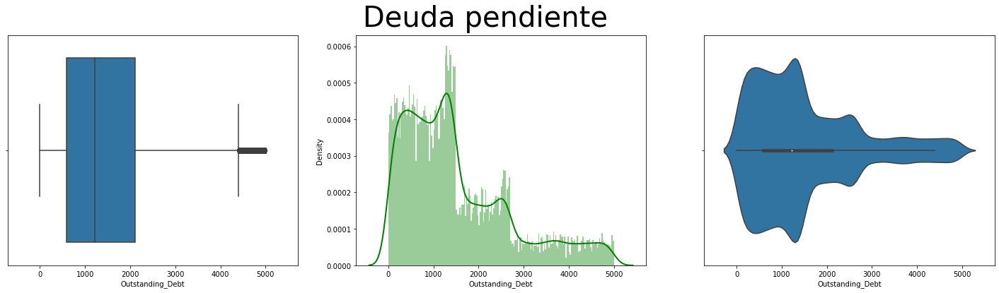

In [117]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Deuda pendiente', fontsize=40)

sns.boxplot(df_credit.Outstanding_Debt,ax = axes[0])
sns.distplot(df_credit.Outstanding_Debt,bins=200,kde_kws={"lw": 2}, color='g',ax = axes[1])
sns.violinplot(df_credit.Outstanding_Debt,orient='v')

En la gráfica es posible visualizar que la mediana de la deuda ronda el valor de 1100, tambien observamos presencia de outliers y una distribucion sesgada hacia la izquieda. 

En el gráfico de distribución podemos identificar 3 segmentaciones, la más frecuente entre 0 y 1500, luego constinuamos con una frecuencia intermedia entre los 1500 y 2700 y por útimo vemos, en menor frecuencia , desde los 2700 a los 5000

In [118]:
df_credit = no_outliers(df_credit, 'Outstanding_Debt')

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Outstanding_Debt'>

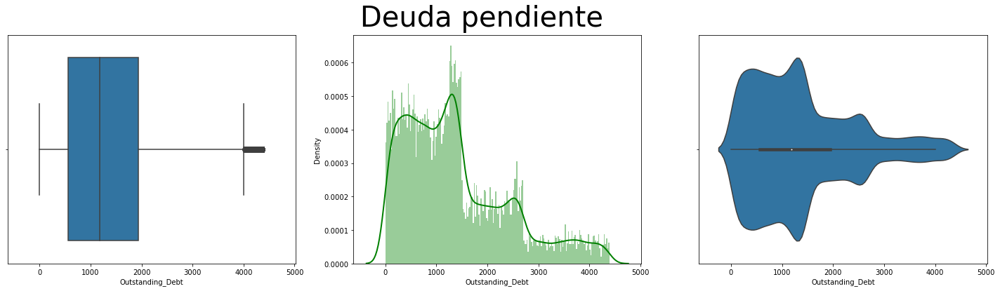

In [119]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Deuda pendiente', fontsize=40)

sns.boxplot(df_credit.Outstanding_Debt,ax = axes[0])
sns.distplot(df_credit.Outstanding_Debt,bins=200,kde_kws={"lw": 2}, color='g',ax = axes[1])
sns.violinplot(df_credit.Outstanding_Debt,orient='v')

In [120]:
df_credit['Outstanding_Debt'].describe()

count    40643.000000
mean      1372.947328
std       1031.011919
min          0.230000
25%        566.210000
50%       1180.560000
75%       1942.000000
max       4394.080000
Name: Outstanding_Debt, dtype: float64

##### Credit_Utilization_Ratio

In [121]:
df_credit.Credit_Utilization_Ratio

1        31.377862
2        24.797347
4        22.537593
5        23.933795
7        38.550848
           ...    
75320    24.713861
75323    25.123535
75324    37.140784
75326    29.135447
75331    33.638208
Name: Credit_Utilization_Ratio, Length: 40643, dtype: float64

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Credit_Utilization_Ratio'>

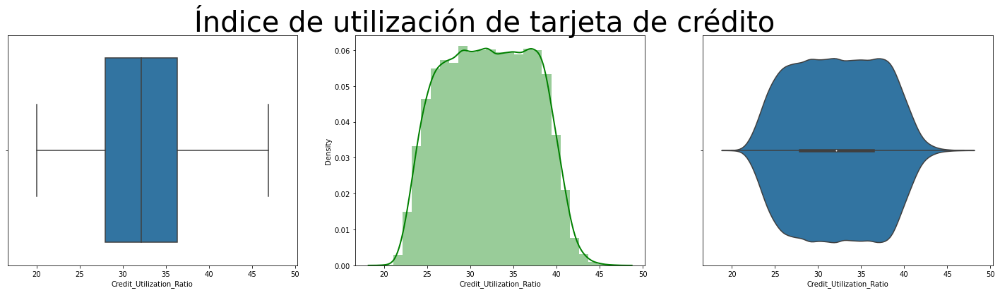

In [122]:
figure, axes = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Índice de utilización de tarjeta de crédito', fontsize=40)

sns.boxplot(df_credit.Credit_Utilization_Ratio,ax = axes[0])
sns.distplot(df_credit.Credit_Utilization_Ratio,bins=25,kde_kws={"lw": 2}, color='g',ax = axes[1])
sns.violinplot(df_credit.Credit_Utilization_Ratio,orient='v')

En general vemos que la media de utilización de crédito disponible está en los 33%, y podemos observar que el porcentaje de utilización de los créditos se concentran entre los 25% y el 38%

##### Total_EMI_per_Month

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Total_EMI_per_month'>

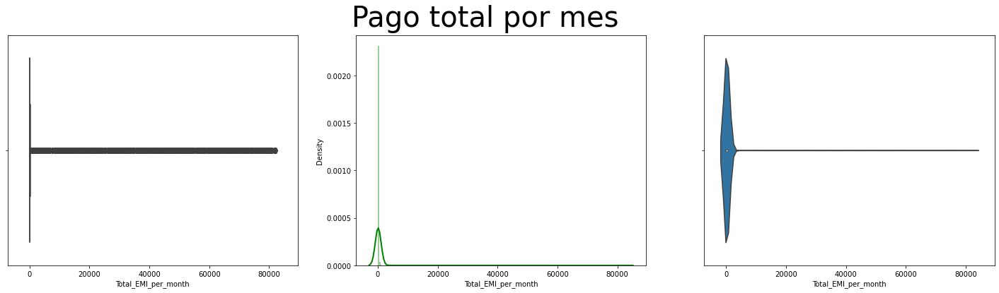

In [123]:
figure, ax = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Pago total por mes', fontsize=40)

sns.boxplot(df_credit.Total_EMI_per_month,ax = ax[0])
sns.distplot(df_credit.Total_EMI_per_month,bins=200,kde_kws={"lw": 2}, color='g',ax = ax[1])
sns.violinplot(df_credit.Total_EMI_per_month,orient='v')

Tratamos Outliers

In [124]:
df_credit = no_outliers(df_credit,'Total_EMI_per_month')

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result

<AxesSubplot:xlabel='Total_EMI_per_month'>

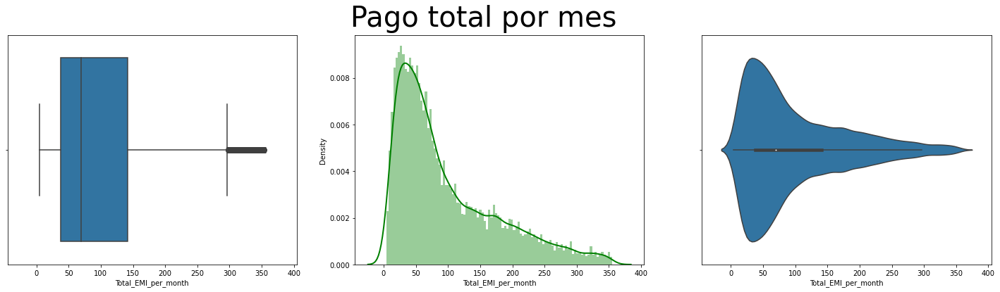

In [125]:
figure, ax = plt.subplots(1, 3, sharex=True, figsize=(25,6))

plt.suptitle('Pago total por mes', fontsize=40)

sns.boxplot(df_credit.Total_EMI_per_month,ax = ax[0])
sns.distplot(df_credit.Total_EMI_per_month,bins=100,kde_kws={"lw": 2}, color='g',ax = ax[1])
sns.violinplot(df_credit.Total_EMI_per_month,orient='v')

In [126]:
df_credit['Total_EMI_per_month'].describe()

count    37976.000000
mean        97.938889
std         79.170536
min          4.462837
25%         37.903006
50%         69.923182
75%        141.267481
max        355.352333
Name: Total_EMI_per_month, dtype: float64

In [127]:
df_credit.head(15)

,Month,Age,Occupation,Annual_Income,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,...,Monthly_Balance,Credit_Score,Auto_Loan,Credit_Builder_Loan,Personal_Loan,Home_Enquity_Loan,Mortgage_Loan,Student_Loan,Debt_Consolidation_Loan,Payday_Loan
1,April,23,Scientist,19114.12,3,4,3,4,5,4.0,...,223.451310,Good,1,1,1,1,0,0,0,0
2,May,23,Scientist,19114.12,3,4,3,4,6,14.0,...,341.489231,Good,1,1,1,1,0,0,0,0
4,July,23,Scientist,19114.12,3,4,3,4,3,8.0,...,244.565317,Good,1,1,1,1,0,0,0,0
5,August,23,Scientist,19114.12,3,4,3,4,3,6.0,...,358.124168,Standard,1,1,1,1,0,0,0,0
7,February,28,Teacher,34847.84,2,4,6,1,7,1.0,...,484.591214,Good,0,1,0,0,0,0,0,0
8,April,28,Teacher,34847.84,2,4,6,1,3,3.0,...,465.676224,Good,0,1,0,0,0,0,0,0
9,May,28,Teacher,34847.84,2,4,6,1,3,1.0,...,444.867032,Good,0,1,0,0,0,0,0,0
10,June,28,Teacher,34847.84,2,4,6,1,3,0.0,...,481.505262,Good,0,1,0,0,0,0,0,0
12,August,28,Teacher,34847.84,2,4,6,1,3,4.0,...,356.078109,Good,0,1,0,0,0,0,0,0
14,February,34,Engineer,143162.64,1,5,8,3,13,6.0,...,998.869297,Good,1,0,0,0,0,0,0,0


## Variables categóricas - Variables Dummies

Una vez analizadas todas las variables, se procede a obtener las variables dummies de las variables categóricas para obtener un dataset útil para el modelado posterior.

En primer lugar, se reemplaza los valores de la variable **Payment_behaviour** mediante números para simplificar el nombre que se usará en dummy.

In [128]:
df_credit['Payment_Behaviour'].value_counts()

Low_spent_Small_value_payments      10907
High_spent_Medium_value_payments     7202
Low_spent_Medium_value_payments      5483
High_spent_Large_value_payments      5374
High_spent_Small_value_payments      4660
Low_spent_Large_value_payments       4350
Name: Payment_Behaviour, dtype: int64

In [129]:
df_credit['Payment_Behaviour'] = df_credit['Payment_Behaviour'].astype('object')

In [130]:
df_credit.loc[df_credit['Payment_Behaviour'] == 'Low_spent_Small_value_payments', 'Payment_Behaviour'] = 0
df_credit.loc[df_credit['Payment_Behaviour'] == 'High_spent_Medium_value_payments', 'Payment_Behaviour'] = 1
df_credit.loc[df_credit['Payment_Behaviour'] == 'Low_spent_Medium_value_payments', 'Payment_Behaviour'] = 2
df_credit.loc[df_credit['Payment_Behaviour'] == 'High_spent_Large_value_payments', 'Payment_Behaviour'] = 3
df_credit.loc[df_credit['Payment_Behaviour'] == 'High_spent_Small_value_payments', 'Payment_Behaviour'] = 4
df_credit.loc[df_credit['Payment_Behaviour'] == 'Low_spent_Large_value_payments', 'Payment_Behaviour'] = 5

In [131]:
df_credit['Payment_Behaviour'].value_counts()

0    10907
1     7202
2     5483
3     5374
4     4660
5     4350
Name: Payment_Behaviour, dtype: int64

Luego, se obtienen las variables dummies de las variables categóricas con más de dos valores posibles, con excepción de la variable respuesta.

In [132]:
df_credit_dummy = pd.get_dummies(df_credit, columns = ['Month', 'Occupation', 'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour'])

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\pandas\core\algorithms.py:798: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  uniques = Index(uniques)


In [133]:
df_credit_dummy.shape

(37976, 58)

In [134]:
df_credit_dummy.reset_index(inplace = True, drop = True)

In [135]:
df_credit_dummy.head(10)

,Age,Annual_Income,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,...,Credit_Mix_Good,Credit_Mix_Standard,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_0,Payment_Behaviour_1,Payment_Behaviour_2,Payment_Behaviour_3,Payment_Behaviour_4,Payment_Behaviour_5
0,23,19114.12,3,4,3,4,5,4.0,6.27,4.0,...,1,0,1,0,1,0,0,0,0,0
1,23,19114.12,3,4,3,4,6,14.0,11.27,4.0,...,1,0,1,0,0,1,0,0,0,0
2,23,19114.12,3,4,3,4,3,8.0,11.27,4.0,...,1,0,1,0,1,0,0,0,0,0
3,23,19114.12,3,4,3,4,3,6.0,11.27,4.0,...,1,0,1,0,0,1,0,0,0,0
4,28,34847.84,2,4,6,1,7,1.0,7.42,2.0,...,1,0,1,0,0,0,0,1,0,0
5,28,34847.84,2,4,6,1,3,3.0,5.42,2.0,...,1,0,1,0,0,0,1,0,0,0
6,28,34847.84,2,4,6,1,3,1.0,6.42,2.0,...,1,0,1,0,1,0,0,0,0,0
7,28,34847.84,2,4,6,1,3,0.0,5.42,2.0,...,1,0,1,0,0,0,0,1,0,0
8,28,34847.84,2,4,6,1,3,4.0,5.42,2.0,...,1,0,1,0,1,0,0,0,0,0
9,34,143162.64,1,5,8,3,13,6.0,7.10,3.0,...,1,0,1,0,0,0,0,0,1,0


In [136]:
df_credit_dummy.describe(include = "all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Age,37976.0,NaN,NaN,NaN,34.258848,9.973222,18.0,26.0,34.0,42.0,56.0
Annual_Income,37976.0,NaN,NaN,NaN,46271.4541,33911.815254,7006.035,18666.56,35142.57,66376.28,150339.96
Num_Bank_Accounts,37976.0,NaN,NaN,NaN,17.236149,118.686495,-1.0,4.0,6.0,7.0,1798.0
Num_Credit_Card,37976.0,NaN,NaN,NaN,22.27994,127.540597,0.0,4.0,6.0,7.0,1497.0
Interest_Rate,37976.0,NaN,NaN,NaN,14.749052,8.698702,1.0,8.0,14.0,20.0,34.0
Num_of_Loan,37976.0,NaN,NaN,NaN,7.220323,58.990999,1.0,2.0,3.0,5.0,1496.0
Delay_from_due_date,37976.0,NaN,NaN,NaN,21.338003,14.686989,0.0,10.0,18.0,28.0,67.0
Num_of_Delayed_Payment,37976.0,NaN,NaN,NaN,13.548425,5.827322,0.0,10.0,14.0,18.0,28.0
Changed_Credit_Limit,37976.0,NaN,NaN,NaN,10.530219,6.405186,0.0,5.8,9.69,14.65,36.29
Num_Credit_Inquiries,37976.0,NaN,NaN,NaN,5.861202,3.837809,0.0,3.0,6.0,9.0,17.0


## Análisis bivariado

In [137]:
df_credit.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37976 entries, 1 to 75331
Data columns (total 29 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Month                     37976 non-null  category
 1   Age                       37976 non-null  int64   
 2   Occupation                37976 non-null  category
 3   Annual_Income             37976 non-null  float64 
 4   Num_Bank_Accounts         37976 non-null  int64   
 5   Num_Credit_Card           37976 non-null  int64   
 6   Interest_Rate             37976 non-null  int64   
 7   Num_of_Loan               37976 non-null  int64   
 8   Delay_from_due_date       37976 non-null  int64   
 9   Num_of_Delayed_Payment    37976 non-null  float64 
 10  Changed_Credit_Limit      37976 non-null  float64 
 11  Num_Credit_Inquiries      37976 non-null  float64 
 12  Credit_Mix                37976 non-null  category
 13  Outstanding_Debt          37976 non-null  floa

Se hace la matriz de correlaciones para las variables numéricas (no categóricas y no dummies)

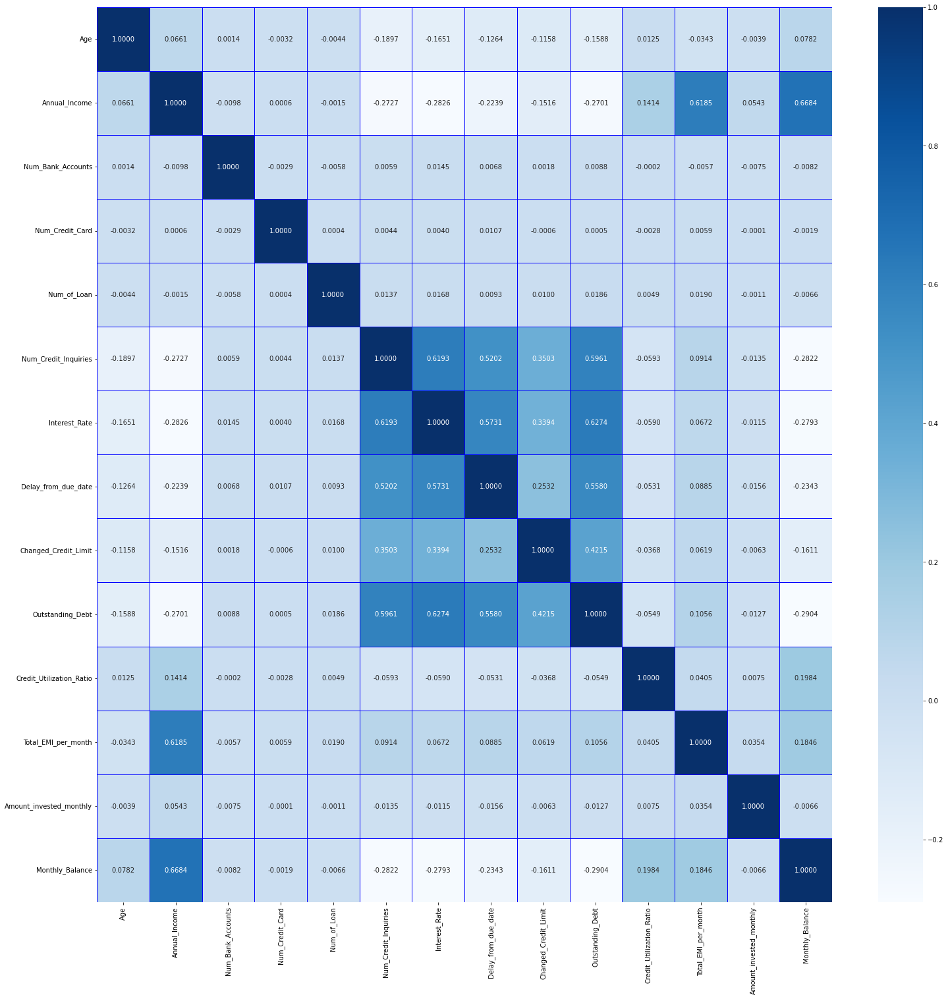

In [138]:
df_credit_corr = df_credit[['Age', 'Annual_Income', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Num_of_Loan', 'Num_Credit_Inquiries', 'Interest_Rate', 'Delay_from_due_date', 'Payment_of_Min_Amount', 'Changed_Credit_Limit', 'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance', 'Credit_Score']]

plt.subplots(nrows=1,ncols=1,figsize=(25,25))
sns.heatmap(df_credit_corr.corr(), annot=True, cmap= 'Blues',linewidths = 0.5,linecolor='b',fmt='0.4f');

En la matriz de correlación, podemos observar claramente las variables con mayor correlación, por lo que pasaremos a realizar las gráficas del tipo scatterplot con las que más correlación tengan.
Previamente se realizará un pairplot con el fin de visualizar todas las variables en cuestión.

Vemos claramente las siguietes correlaciones:

*   Annual Income - Monthly Balance: 66.84%

*   Annual Income - Total_EMI_per_month: 61.85%

*   Num_Credit_Inquiries - Interest_Rate: 61.93%

*   Num_Credit_Inquiries - Delay_from_due_date: 52.02%

*   Num_Credit_Inquiries - Outstanding_Debt: 59.61%

*   Interest_Rate - Delay_from_due_date: 57.31%

*   Interest_Rate - Outstanding_Debt: 62.74%

*   Delay_from_due_date - Outstanding_Debt: 55.80%

*   Changed_Credit_Limit  - Outstanding_Debt: 42.15%

En el siguiente Pairplot vemos un scatterplot con todas las conbinaciones de variable numéricas que existen.

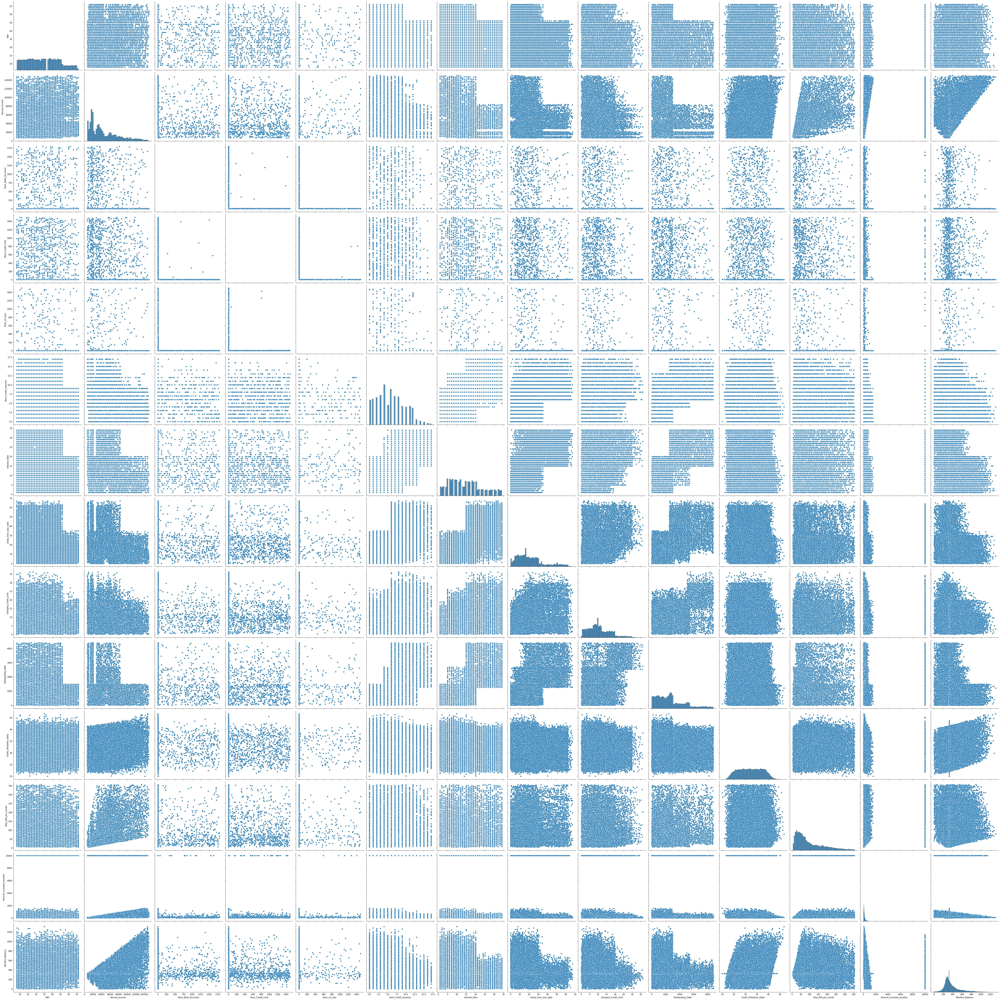

In [139]:
sns.pairplot(data=df_credit_corr, height=5);

Creamos ScatterPlot con todas las variables que tenemos al menos un 50% de correlación

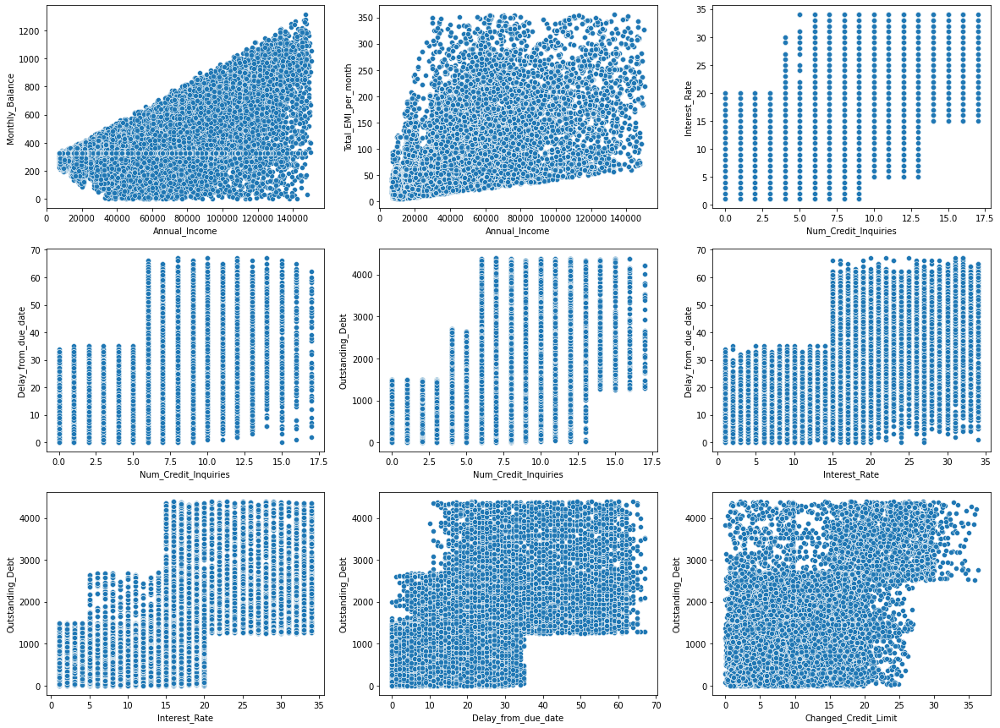

In [140]:
fig, ax = plt.subplots(nrows = 3, ncols = 3, figsize = (20, 15)) 
sns.scatterplot(x = df_credit['Annual_Income'], y = df_credit['Monthly_Balance'], ax= ax[0, 0]);
sns.scatterplot(x = df_credit['Annual_Income'], y = df_credit['Total_EMI_per_month'], ax= ax[0, 1]);
sns.scatterplot(x = df_credit['Num_Credit_Inquiries'], y = df_credit['Interest_Rate'], ax= ax[0, 2]);
sns.scatterplot(x = df_credit['Num_Credit_Inquiries'], y = df_credit['Delay_from_due_date'], ax= ax[1, 0]);
sns.scatterplot(x = df_credit['Num_Credit_Inquiries'], y = df_credit['Outstanding_Debt'], ax= ax[1, 1]);
sns.scatterplot(x = df_credit['Interest_Rate'], y = df_credit['Delay_from_due_date'], ax= ax[1, 2]);
sns.scatterplot(x = df_credit['Interest_Rate'], y = df_credit['Outstanding_Debt'], ax= ax[2, 0]);
sns.scatterplot(x = df_credit['Delay_from_due_date'], y = df_credit['Outstanding_Debt'], ax= ax[2, 1]);
sns.scatterplot(x = df_credit['Changed_Credit_Limit'], y = df_credit['Outstanding_Debt'], ax= ax[2, 2]);

plt.show()

Se puede observar que hay una especie de tendencia creciente en todos los gráficos.

## Análisis multivariado

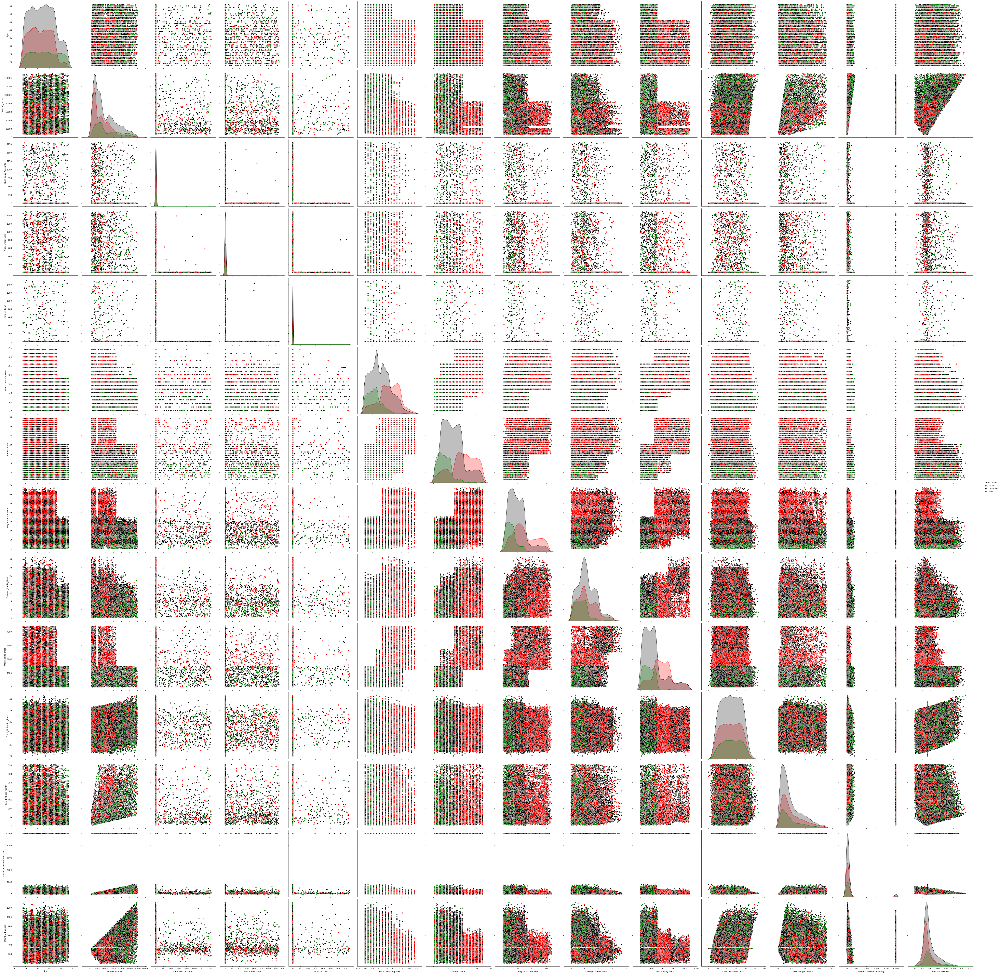

In [141]:
sns.pairplot(data=df_credit_corr,hue='Credit_Score', height=5, palette=['green','black','red']);

Para seguir con el análisis de las variables más correlacionadas, se realizan los mismos gráficos, pero separando según el credit score.

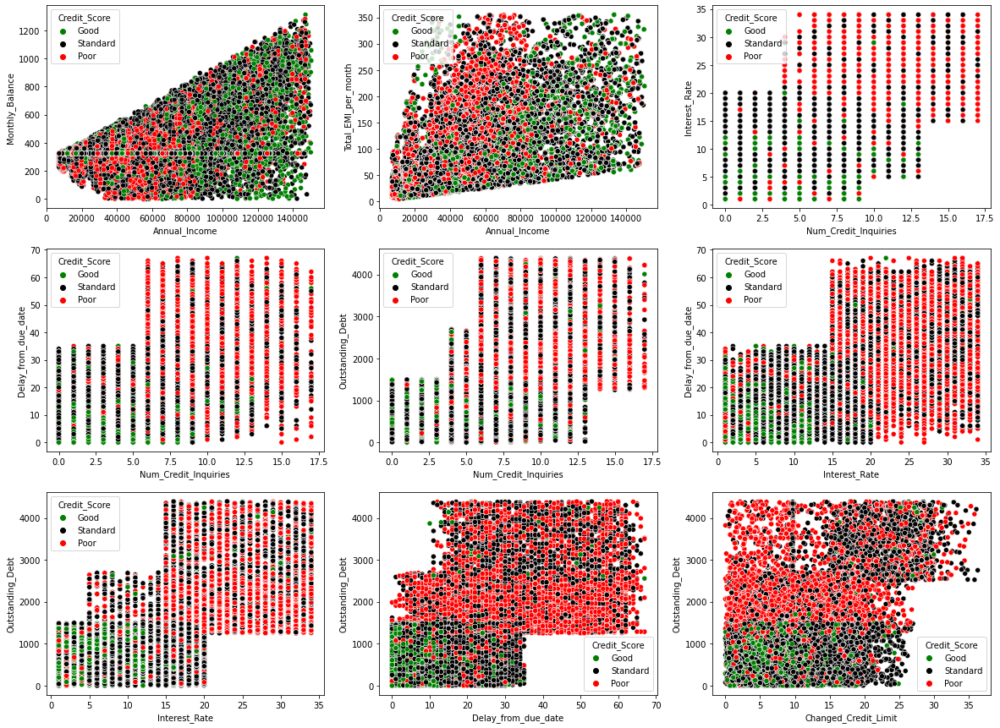

In [142]:
fig, ax = plt.subplots(nrows = 3, ncols = 3, figsize = (20, 15)) 
sns.scatterplot(x = df_credit['Annual_Income'], y = df_credit['Monthly_Balance'], ax= ax[0, 0], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Annual_Income'], y = df_credit['Total_EMI_per_month'], ax= ax[0, 1], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Num_Credit_Inquiries'], y = df_credit['Interest_Rate'], ax= ax[0, 2], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Num_Credit_Inquiries'], y = df_credit['Delay_from_due_date'], ax= ax[1, 0], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Num_Credit_Inquiries'], y = df_credit['Outstanding_Debt'], ax= ax[1, 1], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Interest_Rate'], y = df_credit['Delay_from_due_date'], ax= ax[1, 2], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Interest_Rate'], y = df_credit['Outstanding_Debt'], ax= ax[2, 0], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Delay_from_due_date'], y = df_credit['Outstanding_Debt'], ax= ax[2, 1], hue = df_credit['Credit_Score'], palette=['green','black','red']);
sns.scatterplot(x = df_credit['Changed_Credit_Limit'], y = df_credit['Outstanding_Debt'], ax= ax[2, 2], hue = df_credit['Credit_Score'], palette=['green','black','red']);

plt.show()

Se puede observar en los gráficos que hay zonas bastante separadas entre registros "Good" y registros "Poor". Esto es interesante para el modelo.

In [143]:
df_credit_multiv_num = df_credit[['Age', 'Annual_Income', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Num_of_Loan', 'Num_Credit_Inquiries', 'Interest_Rate', 'Delay_from_due_date', 'Payment_of_Min_Amount', 'Changed_Credit_Limit', 'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance', 'Credit_Score']]

A continuación realizaremos algunas graficas con las variables más relevantes buscando apreciar algún tipo de correlación.

Correlacion entre Age y Annual_Income ==>  0.06607657706597836


<Figure size 700x600 with 0 Axes>

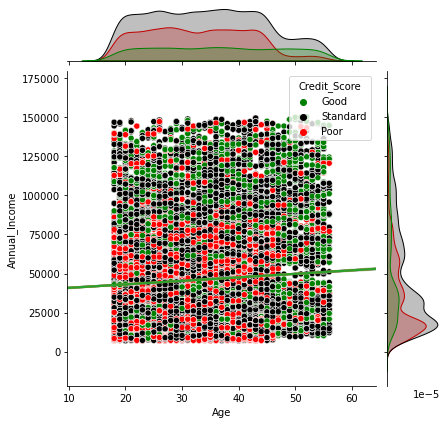

Correlacion entre Age y Num_Bank_Accounts ==>  0.0013707221458034442


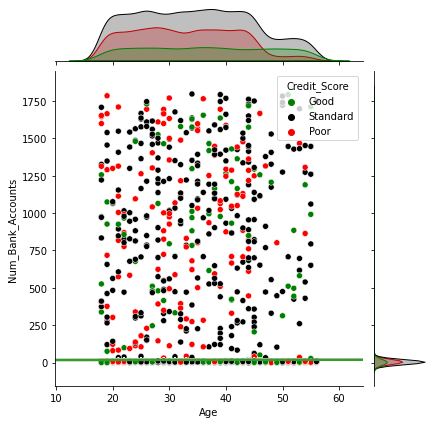

Correlacion entre Age y Num_Credit_Card ==>  -0.003179970483373747


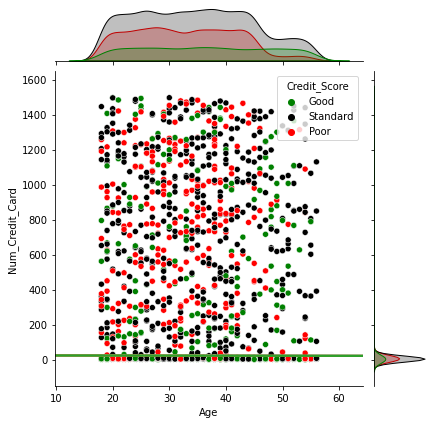

Correlacion entre Age y Num_of_Loan ==>  -0.0044198130909241734


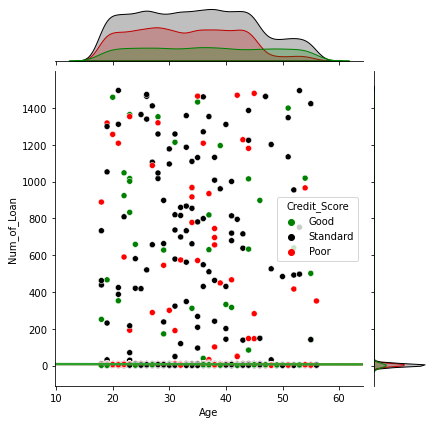

Correlacion entre Age y Num_Credit_Inquiries ==>  -0.1897369001043033


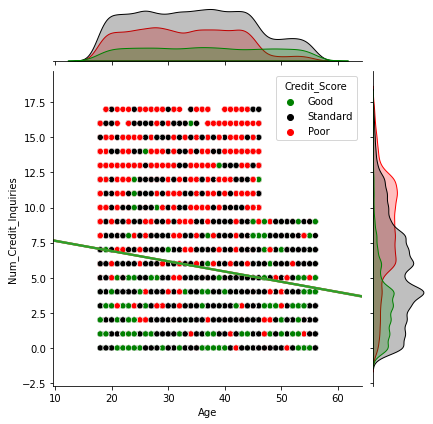

Correlacion entre Age y Interest_Rate ==>  -0.1650870780993095


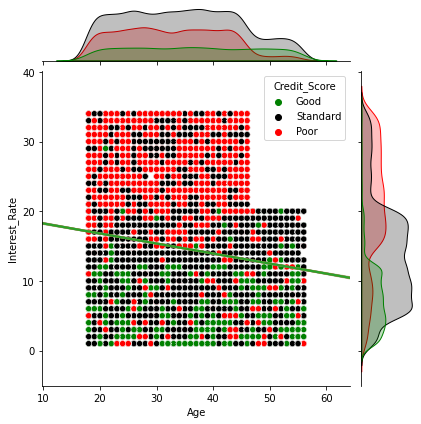

Correlacion entre Age y Delay_from_due_date ==>  -0.12636243083561594


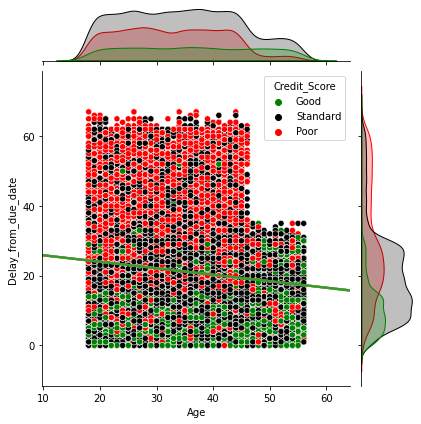

Correlacion entre Age y Changed_Credit_Limit ==>  -0.11582723877480652


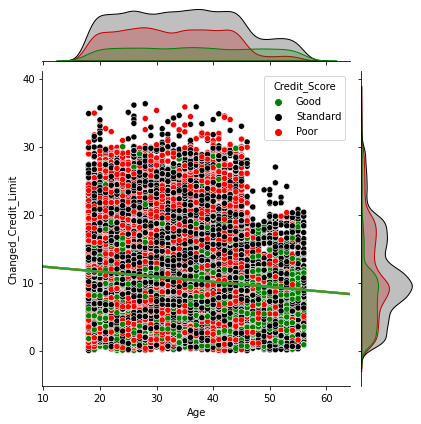

Correlacion entre Age y Outstanding_Debt ==>  -0.15876513459872552


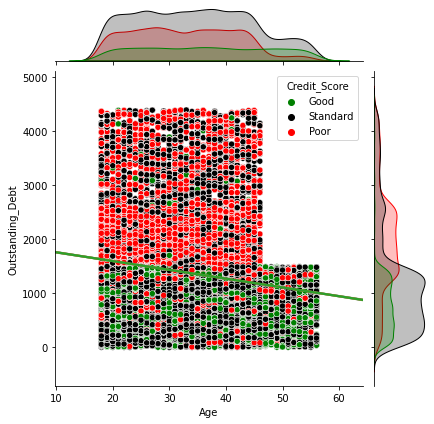

Correlacion entre Age y Credit_Utilization_Ratio ==>  0.01250085517875256


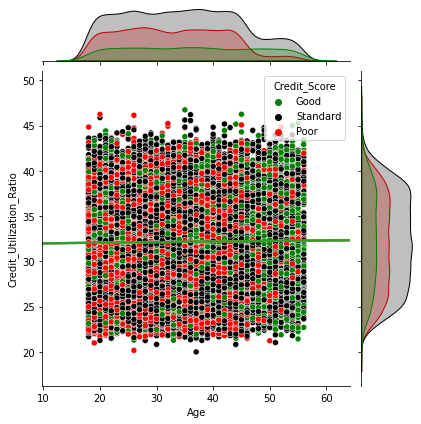

Correlacion entre Age y Total_EMI_per_month ==>  -0.0343383378569251


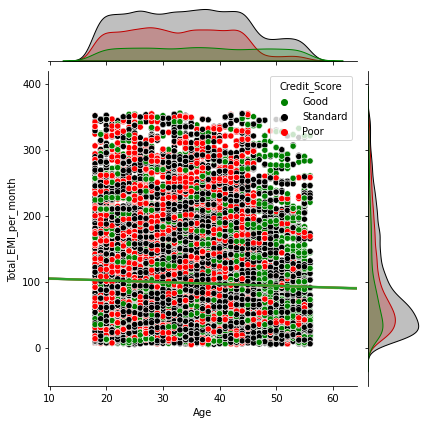

Correlacion entre Age y Amount_invested_monthly ==>  -0.003913170616623077


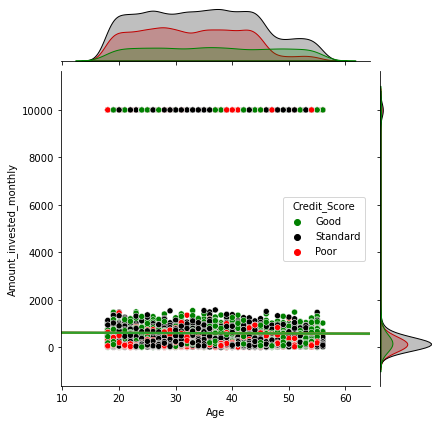

Correlacion entre Age y Monthly_Balance ==>  0.07819386116496334


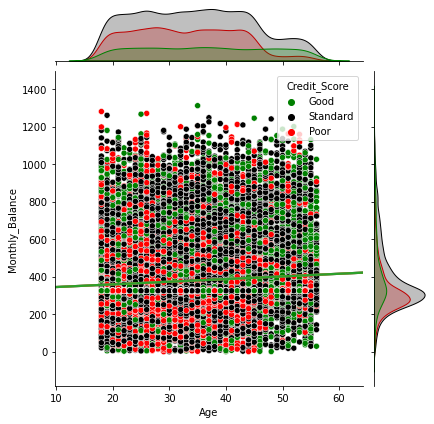

In [144]:
plt.figure(dpi = 100, figsize = (7,6))
# 'scatter', 'hist', 'hex', 'kde', 'reg', 'resid'

for i in  df_credit_multiv_num.columns:
    try:
        if i != 'Age' and i != 'Credit_Score':
            print(f"Correlacion entre Age y {i} ==> ",df_credit_multiv_num.corr().loc['Age'][i])
            ax = sns.jointplot(x='Age', y=i, data = df_credit_multiv_num, hue='Credit_Score', palette=['green','black','red'])
            
            for _,gr in df_credit_multiv_num.groupby('Credit_Score'):
              sns.regplot(x='Age', y= i, data = df_credit_multiv_num, scatter=False, ax=ax.ax_joint, truncate=False)

            plt.show();
    except:f'No se puede obtener una correlacion con la variable: {i}'

Correlacion entre Annual_Income y Age ==>  0.06607657706597836


<Figure size 700x600 with 0 Axes>

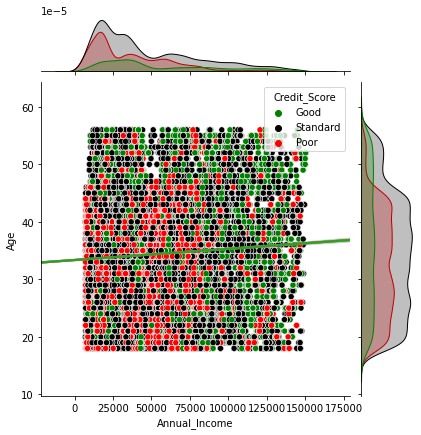

Correlacion entre Annual_Income y Num_Bank_Accounts ==>  -0.009819081757299147


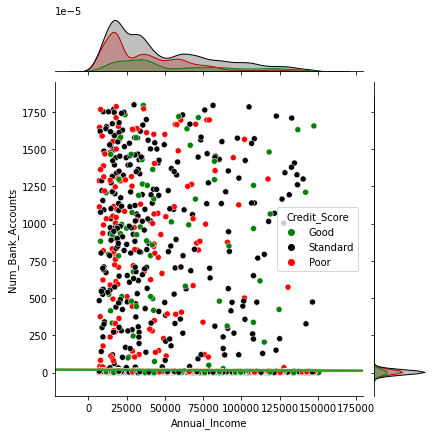

Correlacion entre Annual_Income y Num_Credit_Card ==>  0.0006152818848627899


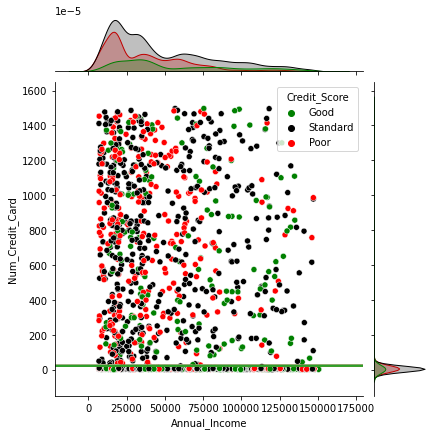

Correlacion entre Annual_Income y Num_of_Loan ==>  -0.0015417891716811673


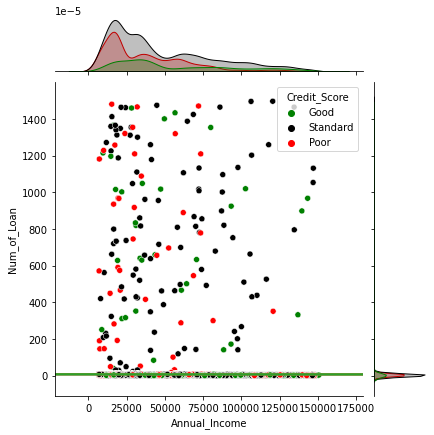

Correlacion entre Annual_Income y Num_Credit_Inquiries ==>  -0.2726600867708707


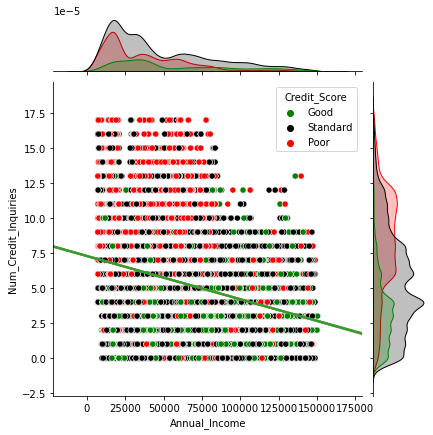

Correlacion entre Annual_Income y Interest_Rate ==>  -0.2825662688176328


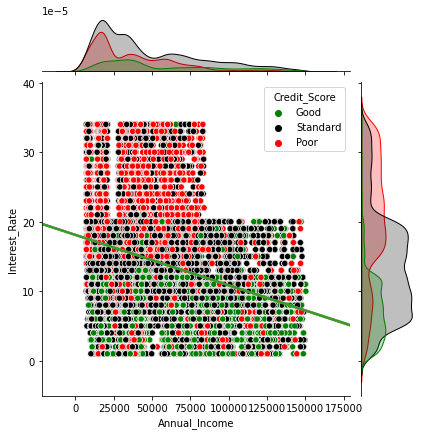

Correlacion entre Annual_Income y Delay_from_due_date ==>  -0.223897042931643


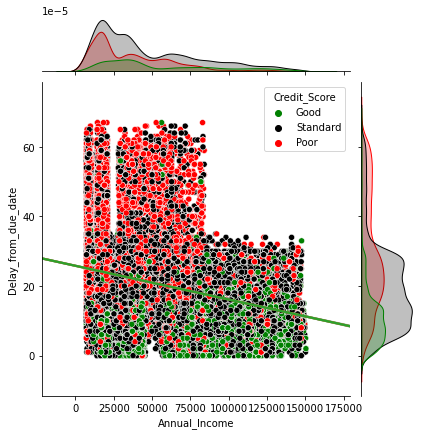

Correlacion entre Annual_Income y Changed_Credit_Limit ==>  -0.15159474726833883


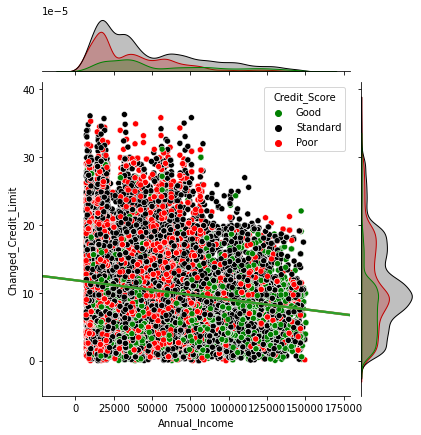

Correlacion entre Annual_Income y Outstanding_Debt ==>  -0.27009663821968444


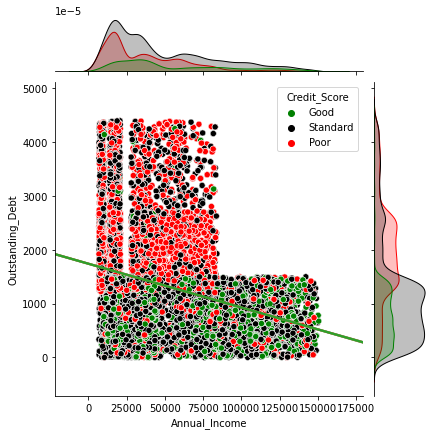

Correlacion entre Annual_Income y Credit_Utilization_Ratio ==>  0.14140266223955292


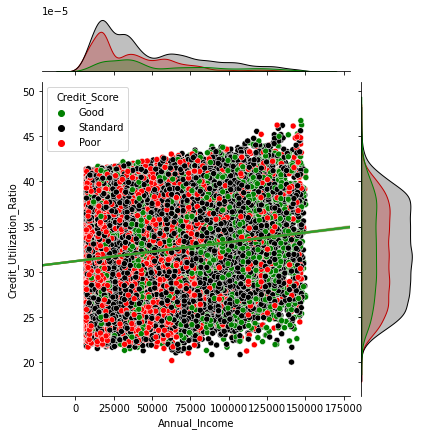

Correlacion entre Annual_Income y Total_EMI_per_month ==>  0.6184504330658063


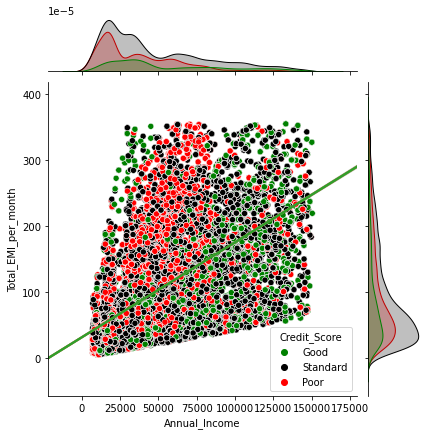

Correlacion entre Annual_Income y Amount_invested_monthly ==>  0.05427048603438392


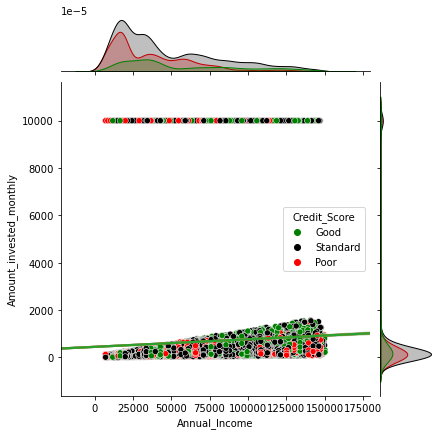

Correlacion entre Annual_Income y Monthly_Balance ==>  0.6683605349151969


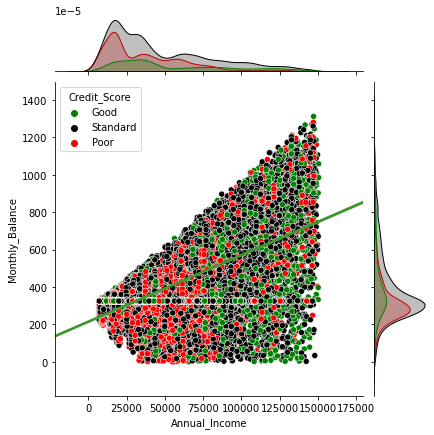

In [145]:
plt.figure(dpi = 100, figsize = (7,6))
# 'scatter', 'hist', 'hex', 'kde', 'reg', 'resid'

for i in  df_credit_multiv_num.columns:
    try:
        if i != 'Annual_Income' and i != 'Credit_Score':
            print(f"Correlacion entre Annual_Income y {i} ==> ",df_credit_multiv_num.corr().loc['Annual_Income'][i])
            ax = sns.jointplot(x='Annual_Income', y=i, data = df_credit_multiv_num, hue='Credit_Score', palette=['green','black','red'])
            
            for _,gr in df_credit_multiv_num.groupby('Credit_Score'):
              sns.regplot(x='Annual_Income', y= i, data = df_credit_multiv_num, scatter=False, ax=ax.ax_joint, truncate=False)

            plt.show();
    except:f'No se puede obtener una correlacion con la variable: {i}'

## Codificación

#### Credit_Score

Para la codificación, se tiene en cuenta lo siguiente:

*   'Poor' -> 0
*   'Standard' -> 1
*   'Good' -> 2

In [146]:
df_credit_dummy['Credit_Score'].value_counts()

Standard    20383
Poor        11538
Good         6055
Name: Credit_Score, dtype: int64

In [147]:
df_credit_dummy.loc[df_credit_dummy['Credit_Score'] == 'Poor', 'Credit_Score'] = 0
df_credit_dummy.loc[df_credit_dummy['Credit_Score'] == 'Standard', 'Credit_Score'] = 1
df_credit_dummy.loc[df_credit_dummy['Credit_Score'] == 'Good', 'Credit_Score'] = 2

In [148]:
df_credit_dummy['Credit_Score'] = df_credit_dummy['Credit_Score'].astype(int)

In [149]:
df_credit_dummy['Credit_Score'].value_counts()

1    20383
0    11538
2     6055
Name: Credit_Score, dtype: int64

In [150]:
df_credit_dummy['Credit_Score'].describe()

count    37976.000000
mean         0.855619
std          0.665156
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          2.000000
Name: Credit_Score, dtype: float64

In [151]:
df_credit_dummy.describe(include = "all").T

,count,mean,std,min,25%,50%,75%,max
Age,37976.0,34.258848,9.973222,18.000000,26.000000,34.000000,42.000000,56.000000
Annual_Income,37976.0,46271.454100,33911.815254,7006.035000,18666.560000,35142.570000,66376.280000,150339.960000
Num_Bank_Accounts,37976.0,17.236149,118.686495,-1.000000,4.000000,6.000000,7.000000,1798.000000
Num_Credit_Card,37976.0,22.279940,127.540597,0.000000,4.000000,6.000000,7.000000,1497.000000
Interest_Rate,37976.0,14.749052,8.698702,1.000000,8.000000,14.000000,20.000000,34.000000
Num_of_Loan,37976.0,7.220323,58.990999,1.000000,2.000000,3.000000,5.000000,1496.000000
Delay_from_due_date,37976.0,21.338003,14.686989,0.000000,10.000000,18.000000,28.000000,67.000000
Num_of_Delayed_Payment,37976.0,13.548425,5.827322,0.000000,10.000000,14.000000,18.000000,28.000000
Changed_Credit_Limit,37976.0,10.530219,6.405186,0.000000,5.800000,9.690000,14.650000,36.290000
Num_Credit_Inquiries,37976.0,5.861202,3.837809,0.000000,3.000000,6.000000,9.000000,17.000000


## Análisis de componentes

Como parte de este análisis, se eliminó la variable **Monthly_Inhand_Salary** antes del análisis univariado. Esto se debe a que la variable eliminada presentaba muchos datos faltantes, por lo que se eliminó de manera temprana para no afectar el dataset.

Se realiza la matriz de correlación para ver si hay variables que tienen una asociación fuerte.

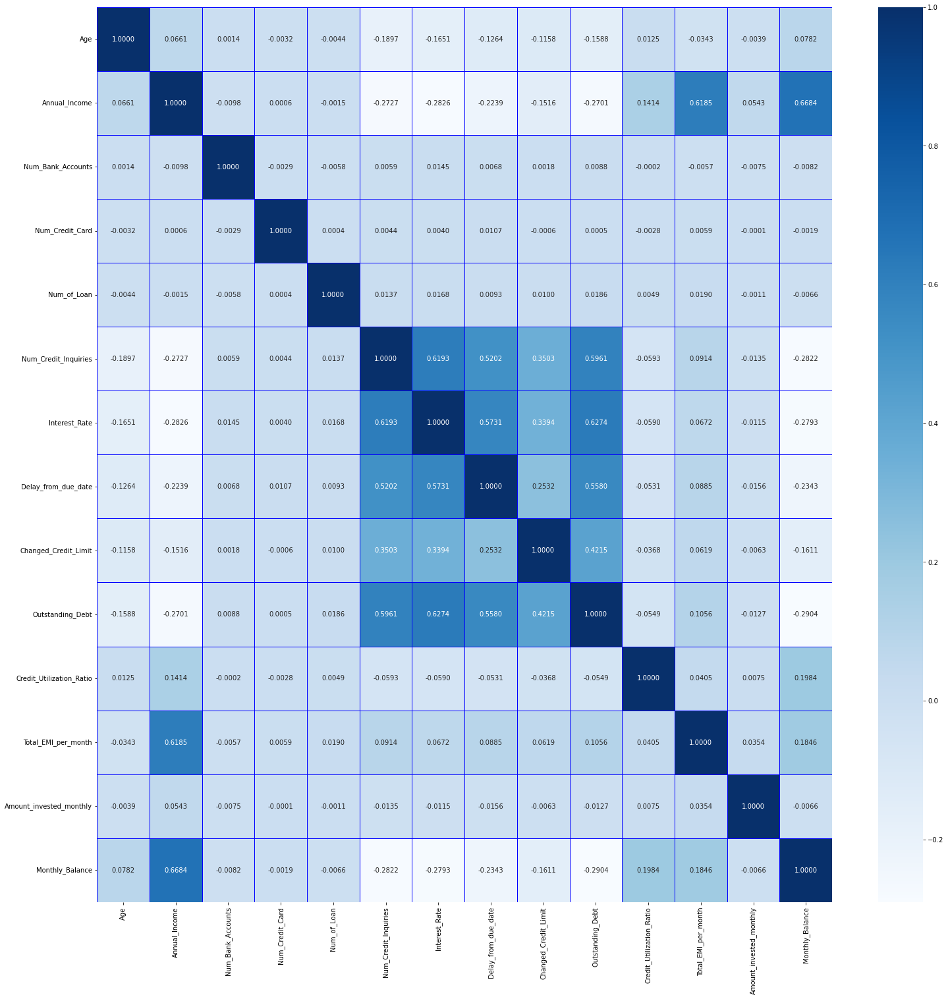

In [152]:
df_credit_corr = df_credit[['Age', 'Annual_Income', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Num_of_Loan', 'Num_Credit_Inquiries', 'Interest_Rate', 'Delay_from_due_date', 'Payment_of_Min_Amount', 'Changed_Credit_Limit', 'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance']]

plt.subplots(nrows=1,ncols=1,figsize=(25,25))
sns.heatmap(df_credit_corr.corr(), annot=True, cmap= 'Blues',linewidths = 0.5,linecolor='b',fmt='0.4f');

En principio, ningún par de variables presentan una correlación alta como para poder simplificar variables. Habría que realizar un análisis más detallado.

### PCA

In [153]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [154]:
#Preprocesamiento
x_pca = df_credit_dummy.drop('Credit_Score', 1)
y_pca = df_credit_dummy['Credit_Score']

#Separamos en train y test
x_train_pca, x_test_pca, y_train_pca, y_test_pca = train_test_split(x_pca, y_pca, test_size = 0.2, random_state = 123)

C:\Users\Adrian\AppData\Local\Temp\ipykernel_25348\2912033255.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  x_pca = df_credit_dummy.drop('Credit_Score', 1)


In [155]:
#Normalizamos los datos para que PCA funcione mejor!
sc = StandardScaler()
X_train = sc.fit_transform(x_train_pca)
X_test = sc.transform(x_test_pca)

In [156]:
#Aplicacion de PCA
pca = PCA()
X_train = pca.fit_transform(x_train_pca)
X_test = pca.transform(x_test_pca)

In [157]:
#Análisis de la varianza explicada para cada componente
explained_variance = pca.explained_variance_ratio_
explained_variance

array([9.95674158e-01, 3.43699981e-03, 8.41696352e-04, 1.56223501e-05,
       1.38116570e-05, 1.22088853e-05, 2.71780282e-06, 2.45413415e-06,
       1.34833023e-07, 8.32888390e-08, 3.60178275e-08, 2.76393026e-08,
       2.11891832e-08, 1.76755196e-08, 6.35002009e-09, 3.28262432e-10,
       1.98831174e-10, 1.98255788e-10, 1.95247006e-10, 1.91869669e-10,
       1.89727500e-10, 1.88532241e-10, 1.84827916e-10, 1.82388635e-10,
       1.48099094e-10, 1.22829260e-10, 1.14312758e-10, 1.09734701e-10,
       1.08521191e-10, 1.08439042e-10, 1.07529360e-10, 1.07274434e-10,
       1.06894661e-10, 1.02937096e-10, 1.00260268e-10, 9.58358311e-11,
       8.03865651e-11, 6.46101872e-11, 5.95868620e-11, 5.89134918e-11,
       5.83800482e-11, 5.81073348e-11, 5.77579463e-11, 5.74799660e-11,
       5.73565806e-11, 5.71859707e-11, 5.59083292e-11, 5.54188235e-11,
       5.51011876e-11, 5.44709801e-11, 5.39915408e-11, 3.88271973e-11,
       9.85903554e-33, 9.85903554e-33, 9.85903554e-33, 9.85903554e-33,
      

Escribir conclusion de esto

## Algoritmos de clasificación

In [164]:
x = df_credit_dummy.drop("Credit_Score", axis=1) #Elimino de mi dataset la variable a predecir
y = df_credit_dummy['Credit_Score'] #Defino el Target

In [165]:
#Me quedo con 30% para test y 70% para train
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state = 42)

### Métricas

In [166]:
def metricas(y_test, prediction):

    Accuracy = accuracy_score(y_test, prediction)
    Precision = precision_score(y_test, prediction, average='weighted') # ! se usa el parámetro average='weighted' debido el target es multiclase y los datos están desbalanceados 
    Recall = recall_score(y_test, prediction, average='weighted')
    F1 = f1_score(y_test, prediction, average='weighted')

    print(f"""
    Accuracy: {Accuracy}
    Precision: {Precision}
    Recall: {Recall}
    F1 score: {F1}
    """)

    # Matriz de confusión: Gráfico
    matriz_confusion = confusion_matrix(y_test, prediction, normalize = 'true')
    # print(matriz_confusion_rl_1)
    fig, ax = plt.subplots(1, figsize = (7, 7))
    ax = sns.heatmap(matriz_confusion, vmin = 0, vmax = 1, annot = True, cmap='Blues')
    ax.set(title = "Matriz de confusión")
    plt.show()


### KNN

In [167]:
clf_knn = KNeighborsClassifier(n_neighbors = 3)

In [168]:
clf_knn.fit(x_train, y_train)

KNeighborsClassifier(n_neighbors=3)

In [169]:
y_test_pred_knn = clf_knn.predict(x_test) #Prediccion en Test


    Accuracy: 0.6521548319143333
    Precision: 0.6473185324146331
    Recall: 0.6521548319143333
    F1 score: 0.6484244839180323
    


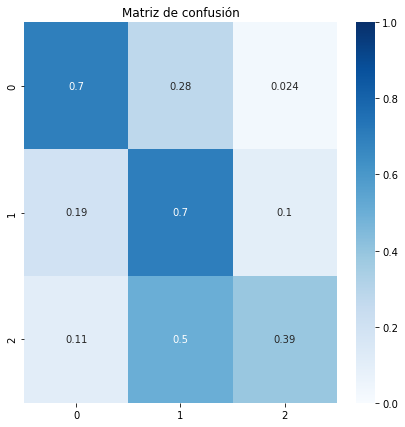

In [170]:
metricas(y_test, y_test_pred_knn)

### Árbol de decisión

In [171]:
clf_tree = DecisionTreeClassifier(max_depth = 7, random_state = 42)  # Se genera el modelo

In [172]:
clf_tree.fit(x_train, y_train)  # Se entrena el modelo

DecisionTreeClassifier(max_depth=7, random_state=42)

In [173]:
y_test_pred_tree = clf_tree.predict(x_test) #Prediccion en Test


    Accuracy: 0.7178969542701659
    Precision: 0.7276885930370799
    Recall: 0.7178969542701659
    F1 score: 0.720483625514538
    


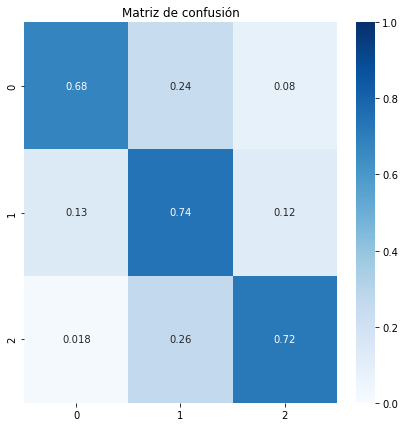

In [174]:
metricas(y_test, y_test_pred_tree)

### Random Forest

#### 1.

In [175]:
# Se pone balanced porque hay un cierto desbalanceo en la variable target
clf_rforest = RandomForestClassifier(random_state=42, n_estimators=100, class_weight="balanced", max_features="log2")

In [176]:
clf_rforest.fit(x_train, y_train)  # Se entrena el modelo

RandomForestClassifier(class_weight='balanced', max_features='log2',
                       random_state=42)

In [177]:
y_test_pred_rforest = clf_rforest.predict(x_test) #Prediccion en Test


    Accuracy: 0.7820591591328009
    Precision: 0.7820827186783689
    Recall: 0.7820591591328009
    F1 score: 0.7820558148720882
    


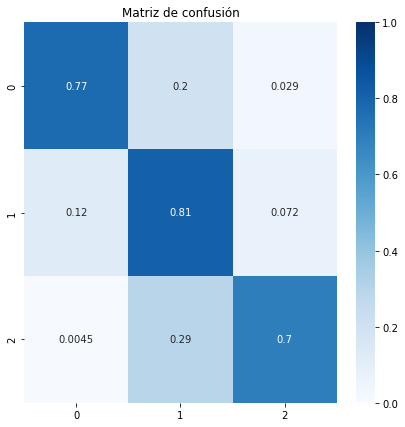

In [178]:
metricas(y_test, y_test_pred_rforest)

#### 2.

In [179]:
# Se pone balanced porque hay un cierto desbalanceo en la variable target
clf_rforest2 = RandomForestClassifier(random_state=42, n_estimators=200, class_weight="balanced", max_features="log2")

In [180]:
clf_rforest2.fit(x_train, y_train)  # Se entrena el modelo

RandomForestClassifier(class_weight='balanced', max_features='log2',
                       n_estimators=200, random_state=42)

In [181]:
y_test_pred_rforest2 = clf_rforest2.predict(x_test) #Prediccion en Test


    Accuracy: 0.7861844992539279
    Precision: 0.7862655248757526
    Recall: 0.7861844992539279
    F1 score: 0.7862108111378499
    


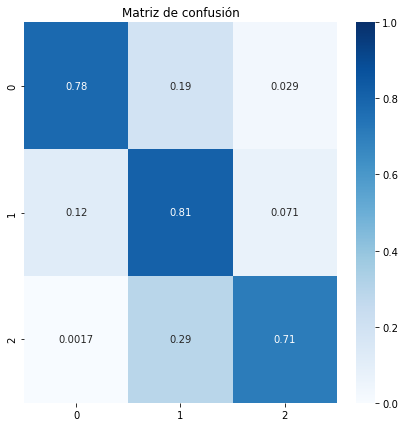

In [182]:
metricas(y_test, y_test_pred_rforest2)

#### 3.

In [183]:
# Se pone balanced porque hay un cierto desbalanceo en la variable target
clf_rforest3 = RandomForestClassifier(random_state=42, n_estimators=200, class_weight="balanced", max_features="sqrt")

In [184]:
clf_rforest3.fit(x_train, y_train)  # Se entrena el modelo

RandomForestClassifier(class_weight='balanced', max_features='sqrt',
                       n_estimators=200, random_state=42)

In [185]:
y_test_pred_rforest3 = clf_rforest3.predict(x_test) #Prediccion en Test


    Accuracy: 0.7879399631352585
    Precision: 0.7878125367903194
    Recall: 0.7879399631352585
    F1 score: 0.7878735399999162
    


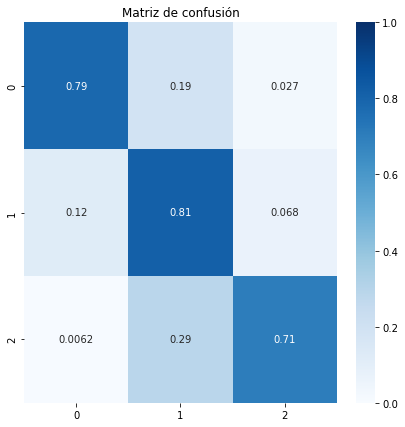

In [186]:
metricas(y_test, y_test_pred_rforest3)

#### 4.

In [187]:
# Se pone balanced porque hay un cierto desbalanceo en la variable target
clf_rforest4 = RandomForestClassifier(random_state=42, n_estimators=200, class_weight="balanced", max_features="log2", min_samples_leaf = 1000)

In [188]:
clf_rforest4.fit(x_train, y_train)  # Se entrena el modelo

RandomForestClassifier(class_weight='balanced', max_features='log2',
                       min_samples_leaf=1000, n_estimators=200,
                       random_state=42)

In [189]:
y_test_pred_rforest4 = clf_rforest4.predict(x_test) #Prediccion en Test


    Accuracy: 0.6860352848240148
    Precision: 0.7399806885665741
    Recall: 0.6860352848240148
    F1 score: 0.6922987734388653
    


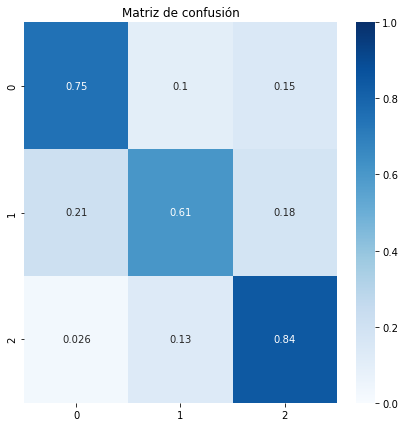

In [190]:
metricas(y_test, y_test_pred_rforest4)

### Regresión logística

#### Modelo Multiclase

In [191]:
# * Creamos el modelo

xrl = df_credit_dummy.drop('Credit_Score', axis = 1) #* definimos la variable independiente
yrl = df_credit_dummy['Credit_Score'].astype(int) #* Variable dependiente

#Me quedo con 30% para test y 70% para train
x_train_rl, x_test_rl, y_train_rl, y_test_rl = train_test_split(xrl, yrl, test_size=0.30, random_state = 42)

In [192]:
model_rl_1 = LogisticRegression(class_weight = 'balanced', multi_class='ovr', random_state = 42, solver = 'newton-cg');
model_rl_1.fit(x_train_rl, y_train_rl);

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py

In [193]:
predictions_rl_1 = model_rl_1.predict(x_test_rl)


    Accuracy: 0.6809444395681559
    Precision: 0.7225165771802977
    Recall: 0.6809444395681559
    F1 score: 0.6871628603943721
    


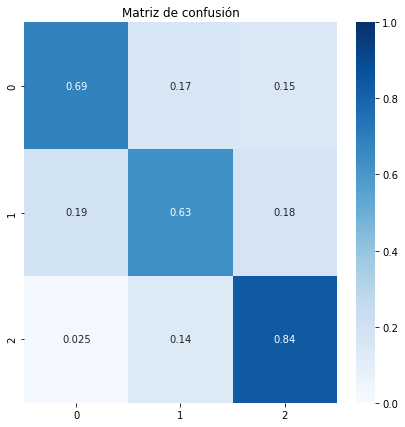

In [194]:
metricas(y_test_rl, predictions_rl_1)

In [195]:
model_rl_1.score(x_test_rl, y_test_rl)

0.6809444395681559

SEPARAR EL TARGET Y HACER 2 MODELOS de REGRESION LOGISTICA

#### Modelo: Poor + Standard | Good 
Poor con Standard serán 0
Good será 1

##### Segmentación de DataFrames

In [196]:
df_credit_dummy_ps = df_credit_dummy.copy() # * Creo un nuevo DF para no pisar.

In [197]:
df_credit_dummy_ps['Credit_Score_PS'] = df_credit_dummy_ps['Credit_Score'] # ? Creo un nuevo campo  Credit_Score_PS igual al Credit_Score

# * Asigno al nuevo campo valores 0 para los Standart y 1 para los Good. Con esto nos queda Poor y Standard con 0 y Good con 1
df_credit_dummy_ps.loc[df_credit_dummy_ps['Credit_Score_PS'] == 1, 'Credit_Score_PS'] = 0
df_credit_dummy_ps.loc[df_credit_dummy_ps['Credit_Score_PS'] == 2, 'Credit_Score_PS'] = 1

df_credit_dummyPS_filtro = df_credit_dummy_ps[df_credit_dummy_ps['Credit_Score_PS']==0] # ? Creo un nuevo DF que muestre solo los valores Poor y Standard
df_credit_dummyPS_filtro.drop('Credit_Score_PS', axis=1, inplace=True) # ? Elimino la colúmna que me quedo todo ceros y trabajo con el target Credit_Score

df_credit_dummy_ps.drop('Credit_Score', axis=1, inplace = True) # ? Elimino la colúmna Credit_Score con 0,1,2 para no complicar el modelo

C:\Users\Adrian\AppData\Local\Temp\ipykernel_25348\4050081838.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_credit_dummyPS_filtro.drop('Credit_Score_PS', axis=1, inplace=True) # ? Elimino la colúmna que me quedo todo ceros y trabajo con el target Credit_Score


##### Primer Modelo
Predicción entre good y el resto

In [198]:
Xps = df_credit_dummy_ps.drop('Credit_Score_PS', axis = 1) #* definimos la variable independiente

yps = df_credit_dummy_ps['Credit_Score_PS'] #* Variable dependiente

In [199]:
#Me quedo con 30% para test y 70% para train
x_train_rl_ps, x_test_rl_ps, y_train_rl_ps, y_test_rl_ps = train_test_split(Xps, yps, test_size=0.30, random_state = 42)

In [200]:
model_rl_ps_1 = LogisticRegression(class_weight = 'balanced', random_state = 42, solver = 'newton-cg')
model_rl_ps_1.fit(x_train_rl_ps, y_train_rl_ps)

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\sklearn\utils\optimize.py:210: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  warnings.warn(


LogisticRegression(class_weight='balanced', random_state=42, solver='newton-cg')

In [201]:
predictions_rl_ps_1 = model_rl_ps_1.predict(x_test_rl_ps)


    Accuracy: 0.8330553848854559
    Precision: 0.8901881073718368
    Recall: 0.8330553848854559
    F1 score: 0.8496388698746562
    


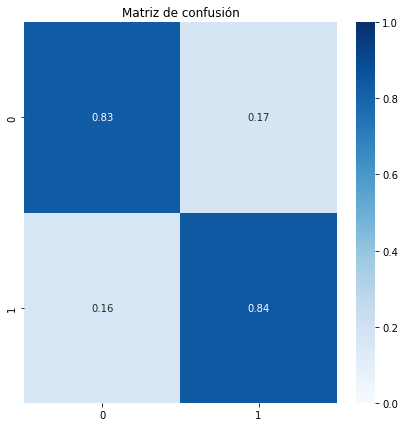

In [202]:
metricas(y_test_rl_ps, predictions_rl_ps_1)

##### Segundo Modelo
Usamos el datasets que contiene solo Poor y Standard

In [203]:
Xpsf = df_credit_dummyPS_filtro.drop('Credit_Score', axis = 1) #* definimos la variable independiente
ypsf = df_credit_dummyPS_filtro['Credit_Score'] #* Variable dependiente

In [204]:
#Me quedo con 30% para test y 70% para train
x_train_rl_psf, x_test_rl_psf, y_train_rl_psf, y_test_rl_psf = train_test_split(Xpsf, ypsf, test_size=0.30, random_state = 42)

In [205]:
model_rl_ps_2 = LogisticRegression(class_weight = 'balanced', random_state = 42, solver = 'newton-cg')
model_rl_ps_2.fit(x_train_rl_psf,y_train_rl_psf)

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py

LogisticRegression(class_weight='balanced', random_state=42, solver='newton-cg')

In [206]:
predictions_rl_ps_2 = model_rl_ps_2.predict(x_test_rl_psf)


    Accuracy: 0.7487731022240786
    Precision: 0.7605663276037432
    Recall: 0.7487731022240786
    F1 score: 0.7519911919710148
    


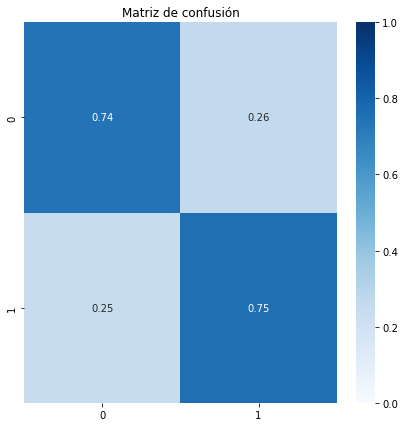

In [207]:
metricas(y_test_rl_psf, predictions_rl_ps_2)

##### Verificación

En construccion. Hay que tomar un conjunto de testeo y pasarlo por el primer modelo. Despues, agarrar los que dieron cero en el primer modelo y meterlo en el segundo modelo. Luego, hay que unir las predicciones y sacar las metricas. Esto seria para obtener metricas de los dos modelos en secuencia.

In [208]:
df_credit_dummy

,Age,Annual_Income,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,...,Credit_Mix_Good,Credit_Mix_Standard,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_0,Payment_Behaviour_1,Payment_Behaviour_2,Payment_Behaviour_3,Payment_Behaviour_4,Payment_Behaviour_5
0,23,19114.12,3,4,3,4,5,4.0,6.27,4.0,...,1,0,1,0,1,0,0,0,0,0
1,23,19114.12,3,4,3,4,6,14.0,11.27,4.0,...,1,0,1,0,0,1,0,0,0,0
2,23,19114.12,3,4,3,4,3,8.0,11.27,4.0,...,1,0,1,0,1,0,0,0,0,0
3,23,19114.12,3,4,3,4,3,6.0,11.27,4.0,...,1,0,1,0,0,1,0,0,0,0
4,28,34847.84,2,4,6,1,7,1.0,7.42,2.0,...,1,0,1,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37971,28,20002.88,10,8,29,5,35,26.0,18.31,9.0,...,0,0,0,1,0,0,0,1,0,0
37972,28,20002.88,10,8,29,5,33,25.0,18.31,9.0,...,0,0,0,1,1,0,0,0,0,0
37973,28,20002.88,10,8,29,5,33,26.0,18.31,9.0,...,0,0,0,1,0,0,0,0,0,1
37974,29,20002.88,10,8,29,5,33,25.0,18.31,9.0,...,0,0,0,1,0,0,0,1,0,0


#### Modelo: Good + Standard | Poor 
Good con Standard serán 1
Poor será 0

##### Segmentación de DataFrames

In [209]:
df_credit_dummy_gs = df_credit_dummy.copy() # * Creo un nuevo DF para no pisar.

In [210]:
df_credit_dummy_gs['Credit_Score_GS'] = df_credit_dummy_gs['Credit_Score'] # ? Crea nueva columna

df_credit_dummy_gs.loc[df_credit_dummy_gs['Credit_Score_GS'] == 2, 'Credit_Score_GS'] = 1 # ? cambio los valores de good a 1

df_credit_dummy_gs_filtro = df_credit_dummy_gs[df_credit_dummy_gs['Credit_Score_GS']==1] # ? Creo un nuevo df con good y Standard
df_credit_dummy_gs_filtro = df_credit_dummy_gs.drop('Credit_Score_GS', axis=1) # ? Elimina la columna con 1 creada
df_credit_dummy_gs_filtro.loc[df_credit_dummy_gs['Credit_Score'] == 2, 'Credit_Score'] = 0 # ? busca los 2 para pasarlos a 0. Los good pasan a ser 0 y Standard quedan como 1

df_credit_dummy_gs.drop('Credit_Score', axis=1, inplace=True) # ? se elimina la columna credit score para df_credit_dummy_gs

##### Primer Modelo
Predicción entre Poor y el resto

In [211]:
Xgs = df_credit_dummy_gs.drop('Credit_Score_GS', axis = 1) #* definimos la variable independiente
ygs = df_credit_dummy_gs['Credit_Score_GS'] #* Variable dependiente

In [212]:
#Me quedo con 30% para test y 70% para train
x_train_rl_gs, x_test_rl_gs, y_train_rl_gs, y_test_rl_gs = train_test_split(Xgs, ygs, test_size=0.30, random_state = 42)

In [213]:
model_rl_gs_1 = LogisticRegression(class_weight = 'balanced', random_state = 42, solver = 'newton-cg')
model_rl_gs_1.fit(x_train_rl_gs,y_train_rl_gs)

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py

LogisticRegression(class_weight='balanced', random_state=42, solver='newton-cg')

In [214]:
predictions_rl_gs_1 = model_rl_gs_1.predict(x_test_rl_gs)


    Accuracy: 0.7860089528657948
    Precision: 0.7981767293970541
    Recall: 0.7860089528657948
    F1 score: 0.7901137780049787
    


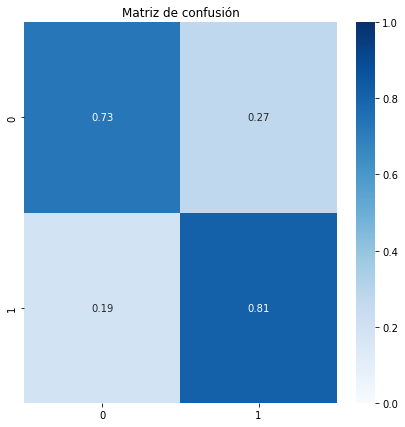

In [215]:
metricas(y_test_rl_gs, predictions_rl_gs_1)

##### Segundo Modelo
Dejamos datos relacionados con Good y Standard

In [216]:
Xgsf = df_credit_dummy_gs_filtro.drop('Credit_Score', axis = 1) #* definimos la variable independiente
ygsf = df_credit_dummy_gs_filtro['Credit_Score'] #* Variable dependiente

In [217]:
#Me quedo con 30% para test y 70% para train
x_train_rl_gsf, x_test_rl_gsf, y_train_rl_gsf, y_test_rl_gsf = train_test_split(Xgsf, ygsf, test_size=0.30, random_state = 42)

In [218]:
model_rl_gs_2 = LogisticRegression(class_weight = 'balanced', random_state = 42, solver = 'newton-cg')
model_rl_gs_2.fit(x_train_rl_gsf,y_train_rl_gsf)

c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
c:\Users\Adrian\anaconda3\envs\envgeneral\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)


LogisticRegression(class_weight='balanced', random_state=42, solver='newton-cg')

In [219]:
predictions_rl_gs_2 = model_rl_ps_2.predict(x_test_rl_gsf)


    Accuracy: 0.678486790134293
    Precision: 0.6778826557830322
    Recall: 0.678486790134293
    F1 score: 0.6760028657294601
    


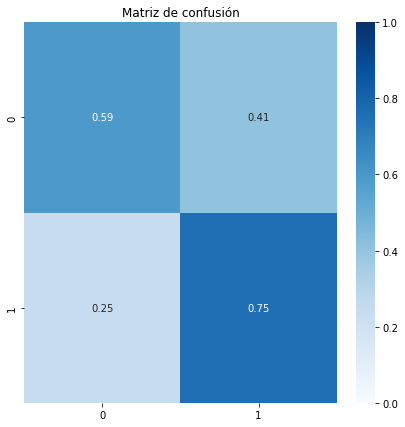

In [220]:
metricas(y_test_rl_gsf, predictions_rl_gs_2)